# task for tommorow

- get model converted and usable by HF
- fix and clear training files
- get RMSN trained
- check PN

---

- close GPU when leave

To evaluate the performance of different types of Layer Normalization (LN) in your model, you should consider a mix of traditional NLP metrics and specific analyses that align with your research focus. Here’s a breakdown of the metrics you could use:

### 1. **Perplexity**
   - **What it Measures:** Perplexity is a standard metric for language models, indicating how well the model predicts a sample. Lower perplexity suggests better performance.
   - **How to Use:** Compare the perplexity across models trained with different types of LN.

### 2. **Accuracy on Downstream Tasks**
   - **What it Measures:** The effectiveness of different LNs on specific tasks like text classification, sentiment analysis, or question answering.
   - **How to Use:** Fine-tune your model on a variety of tasks and compare the accuracy. For instance, use datasets like GLUE or SuperGLUE.

### 3. **Fine-tuning Performance**
   - **What it Measures:** The adaptability of the model when fine-tuned on new datasets.
   - **How to Use:** Measure the performance improvements after fine-tuning on smaller, task-specific datasets. Track metrics like accuracy, F1-score, or ROUGE depending on the task.

### 4. **Training Stability**
   - **What it Measures:** How different LNs impact the stability of training, such as convergence speed and whether the model suffers from vanishing or exploding gradients.
   - **How to Use:** Monitor training logs for loss curves and gradient norms to assess stability.

### 5. **Memory Usage and Computational Efficiency**
   - **What it Measures:** The resource efficiency of different LN techniques.
   - **How to Use:** Compare GPU memory usage, training time per epoch, and overall computational cost.

### 6. **Generalization Ability**
   - **What it Measures:** How well the model generalizes to unseen data.
   - **How to Use:** Evaluate the model on out-of-distribution datasets or by holding out a specific portion of the data during fine-tuning.

### 7. **Calibration Metrics**
   - **What it Measures:** The confidence level of the model in its predictions.
   - **How to Use:** Use metrics like Expected Calibration Error (ECE) to assess how confident and accurate the model's predictions are.

### 8. **Robustness to Noise**
   - **What it Measures:** How different LNs handle noisy or adversarial inputs.
   - **How to Use:** Test the model with noisy or perturbed data to see how performance degrades.

### 9. **Layer-wise Analysis**
   - **What it Measures:** The impact of LN at different layers of the model.
   - **How to Use:** Analyze the activations or outputs from different layers to see how LN affects each stage of the model.

### 10. **Ablation Studies**
   - **What it Measures:** The importance of specific components or types of LN.
   - **How to Use:** Remove or replace certain LNs and observe how performance metrics change.

### Summary

Incorporating fine-tuning into your evaluation is a great idea, as it will help you see how each type of LN performs in practice beyond just training the base model. The combination of perplexity, downstream task performance, fine-tuning efficiency, and training stability should give you a comprehensive view of the strengths and weaknesses of each LN variant.

Ablation studies involve systematically removing or modifying certain components of your model to understand their impact on performance. Here’s how you can conduct an ablation study specifically for Layer Normalization (LN):

### Steps for Conducting an Ablation Study

1. **Identify the Layers with LN:**
   - Identify where the different types of LN are applied in your model, such as pre-layer, post-layer, or within specific components like attention blocks.

2. **Remove or Modify LN Layers:**
   - **Complete Removal:** Remove the LN layers entirely from the identified positions. This will help you understand the contribution of LN to model stability and performance.
   - **Partial Removal:** Remove LN from specific parts of the model (e.g., only in the attention blocks or only in the MLP layers) to see how it affects performance.
   - **Replacement:** Replace the LN with another normalization technique, such as Batch Normalization (BN) or Group Normalization (GN), to see if the results change.

3. **Fine-tune the Model (If Needed):**
   - If you remove or modify the LN layers, fine-tuning the model on a downstream task can help you observe the impact on performance without the need to train from scratch.

4. **Evaluate Performance:**
   - Use the same metrics you applied in your main evaluation (e.g., perplexity, task accuracy, training stability) to assess the impact of removing or replacing the LN layers.
   - Pay particular attention to training dynamics, such as whether the model still converges or if it becomes unstable.

5. **Compare Results:**
   - Compare the performance of the model with and without LN (or with different types of LN) to understand its importance.
   - Analyze which layers benefit most from LN and whether removing LN from certain parts has a more significant impact than others.

### Do You Need to Train from Scratch?

- **Fine-tuning Suffices for Most Cases:** In most ablation studies, especially if the change is minor (like removing LN), you can start with a pre-trained model and fine-tune it after the modification. This approach is faster and still provides valuable insights.
  
- **Train from Scratch for Comprehensive Insights:** If you want to understand the full impact of LN on model training dynamics (e.g., how LN influences convergence or how the model learns from the start), training from scratch would be more appropriate. This approach is more resource-intensive but can offer deeper insights into the role of LN.

### Practical Approach

- **Start with Fine-tuning:** Remove LN layers and fine-tune your pre-trained model. This will give you an initial understanding of the impact without the computational cost of training from scratch.
  
- **Consider Training from Scratch:** If you observe significant differences during fine-tuning or if your research focus includes understanding the training process itself, consider training from scratch.

By conducting the ablation study this way, you’ll gain a clearer understanding of the importance of LN in your model, helping you to draw meaningful conclusions in your research paper.

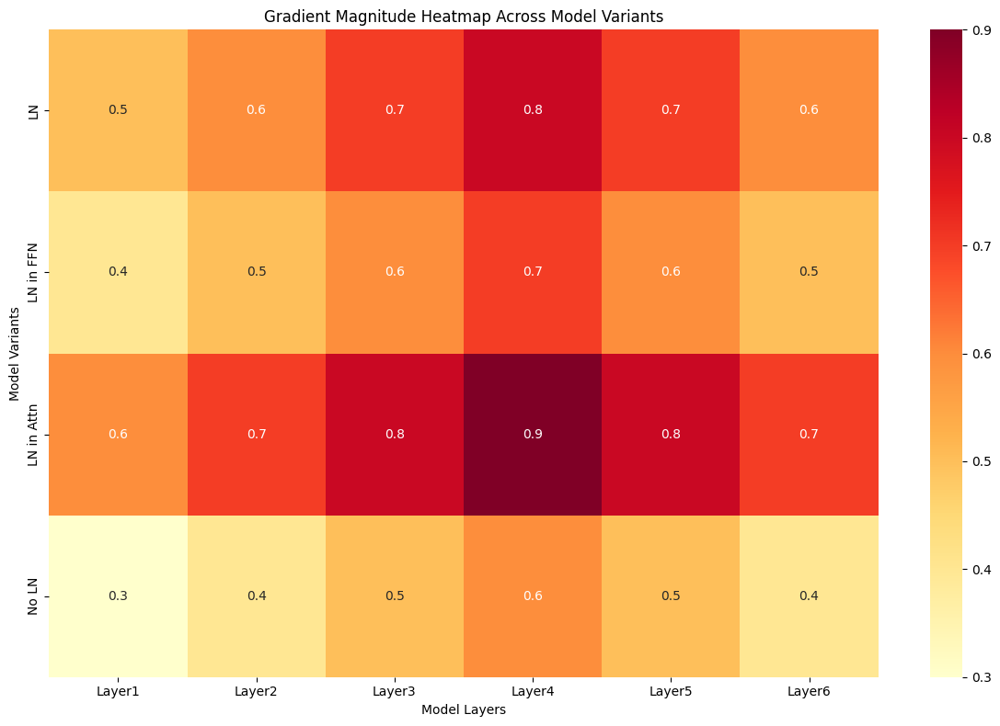

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Example data (replace with your actual gradient magnitudes)
data = np.array([
    [0.5, 0.6, 0.7, 0.8, 0.7, 0.6],  # LN
    [0.4, 0.5, 0.6, 0.7, 0.6, 0.5],  # LN in FFN
    [0.6, 0.7, 0.8, 0.9, 0.8, 0.7],  # LN in Attention
    [0.3, 0.4, 0.5, 0.6, 0.5, 0.4]   # No LN
])

# Create heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(data, annot=True, cmap='YlOrRd',
            xticklabels=['Layer1', 'Layer2', 'Layer3', 'Layer4', 'Layer5', 'Layer6'],
            yticklabels=['LN', 'LN in FFN', 'LN in Attn', 'No LN'])

plt.title('Gradient Magnitude Heatmap Across Model Variants')
plt.xlabel('Model Layers')
plt.ylabel('Model Variants')
plt.tight_layout()
plt.show()

# Heatmap Graphing

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer

def calculate_gradient_magnitudes(model_name, prompt):
    model = AutoModelForCausalLM.from_pretrained(model_name)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")

    # Enable gradient computation
    model.train()

    # Tokenize input
    inputs = tokenizer(prompt, return_tensors="pt")

    # Forward pass
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss

    # Backward pass
    loss.backward()

    # Calculate gradient magnitudes
    gradient_magnitudes = {}
    for name, param in model.named_parameters():
        if param.grad is not None:
            gradient_magnitudes[name] = param.grad.abs().mean().item()

    return gradient_magnitudes

# Example usage:
# model_name = "shng2025/GPT-Valkyrie_LN-124m__baseModel__"
# prompt = "Once upon a time"
# gradient_magnitudes = calculate_gradient_magnitudes(model_name, prompt)

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

def visualize_gradient_vertical(gradient_magnitudes, model_name):
    # Convert gradient magnitudes to a DataFrame
    df = pd.DataFrame(list(gradient_magnitudes.items()), columns=['Parameter', 'Gradient Magnitude'])
    df[['Layer', 'Component']] = df['Parameter'].str.split('.', n=1, expand=True)

    # Extract layer numbers and sort
    df['Layer_Num'] = df['Layer'].str.extract('(\d+)').astype(float)
    df = df.sort_values(['Layer_Num', 'Component'])

    # Create the plot
    fig, ax = plt.subplots(figsize=(10, len(df) * 0.3))  # Adjust figure height based on number of rows

    # Plot gradient magnitudes
    y_positions = range(len(df))
    ax.barh(y_positions, df['Gradient Magnitude'], align='center', alpha=0.8)

    # Customize the plot
    ax.set_yticks(y_positions)
    ax.set_yticklabels(df['Parameter'])
    ax.invert_yaxis()  # Labels read top-to-bottom
    ax.set_xlabel('Gradient Magnitude')
    ax.set_title(f"Gradient Magnitudes for {model_name}")

    # Add gradient magnitude values to the right side
    for i, v in enumerate(df['Gradient Magnitude']):
        ax.text(v, i, f'{v:.2e}', va='center')

    plt.tight_layout()
    plt.show()


Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


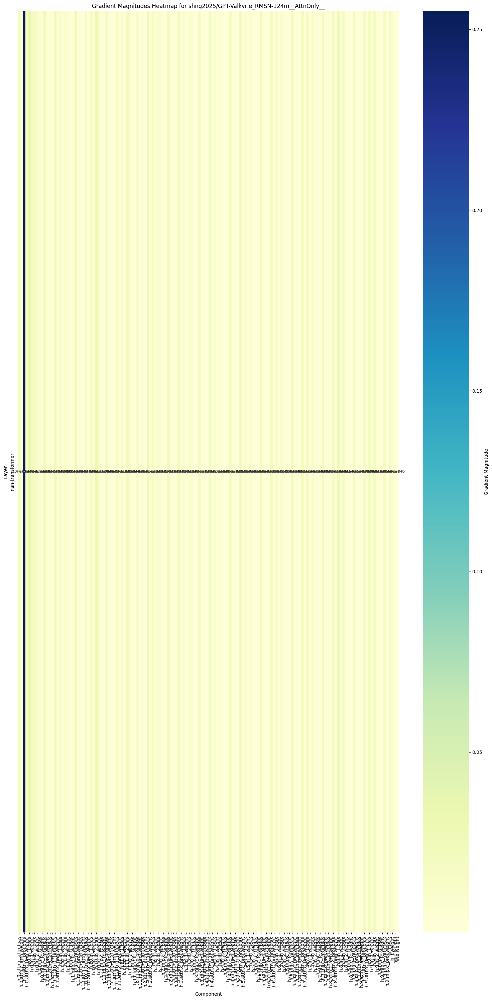



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__FFNonly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


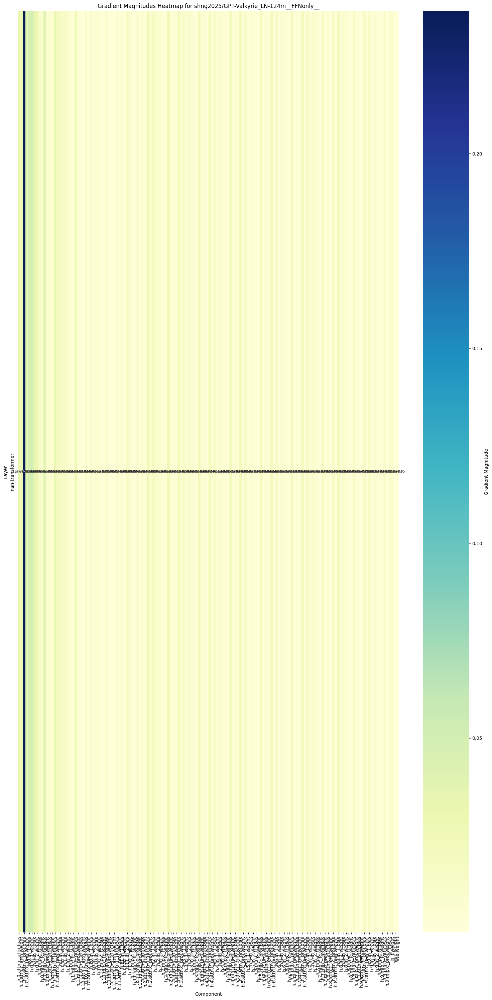



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


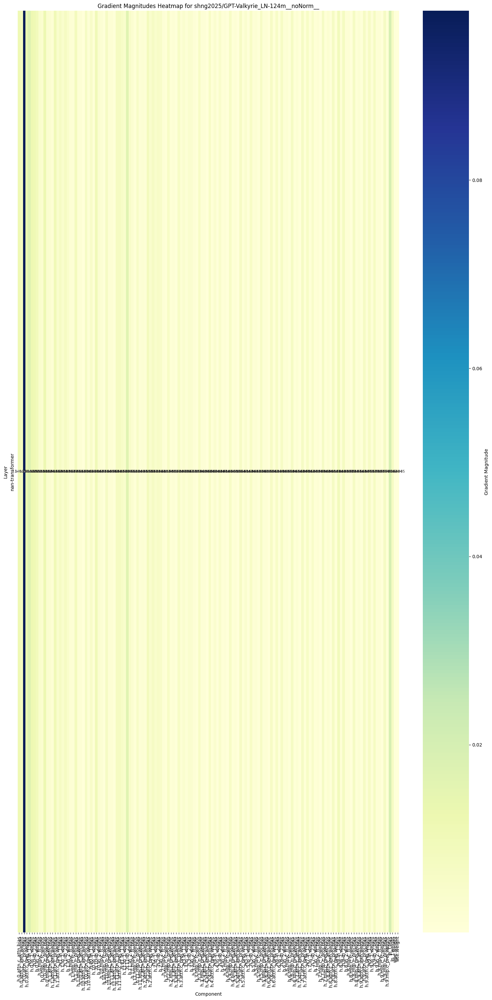



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


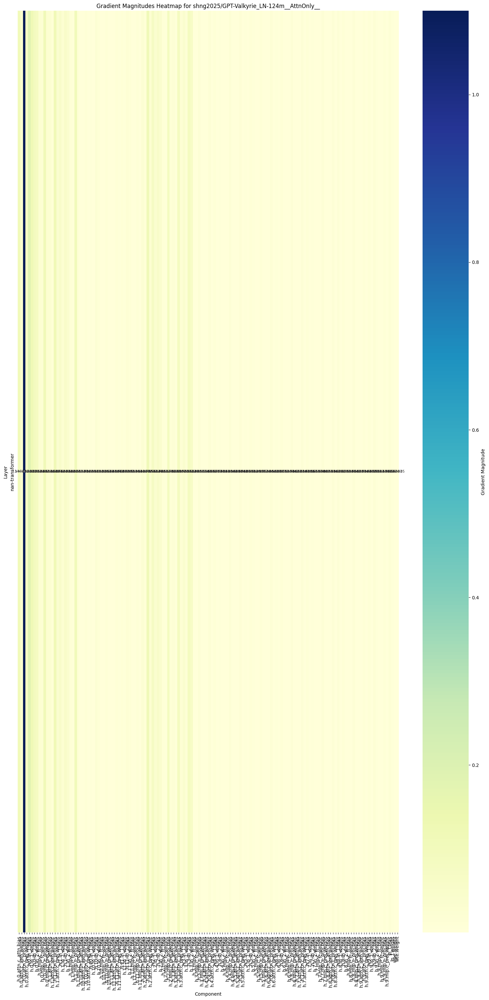



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


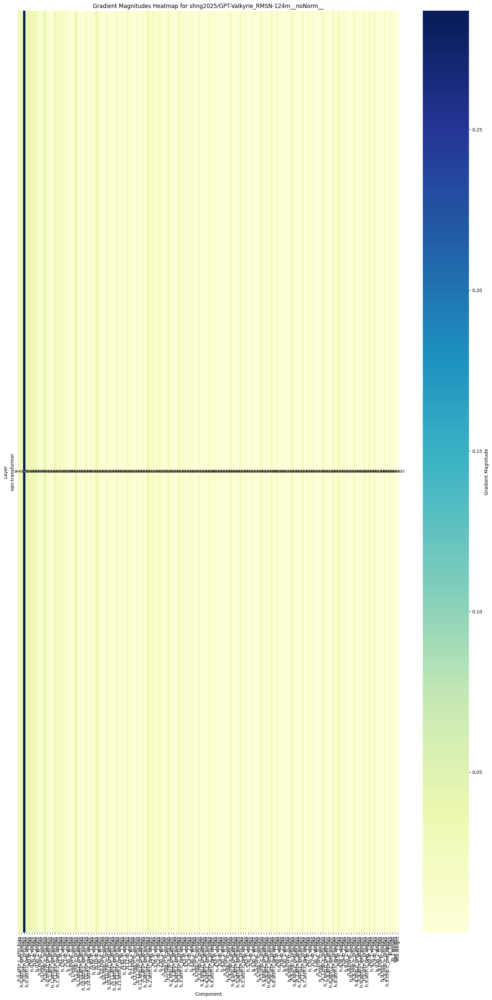



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


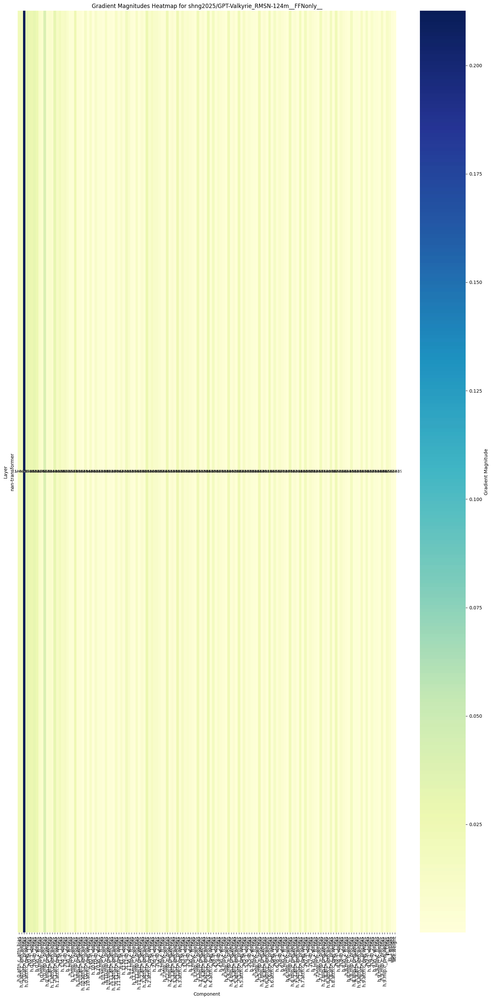



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__baseModel__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


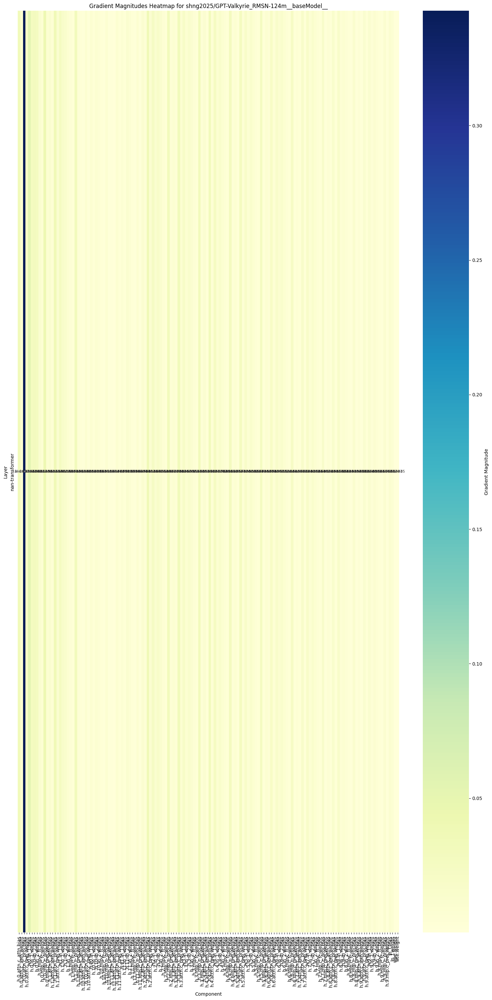



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__baseModel__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


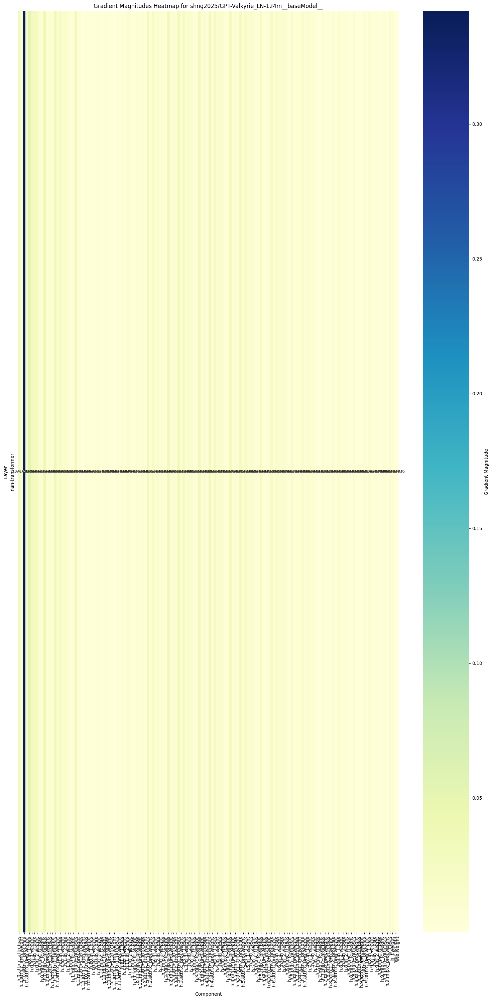

In [ ]:
# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__"
]

# Prompt to use for inference
prompt = "Once upon a time in a land far, far away"

# Compare gradient magnitudes for each model variant
for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    gradient_magnitudes = calculate_gradient_magnitudes(model_name, prompt)
    visualize_gradient_heatmap(gradient_magnitudes, model_name)
    print("\n")

Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


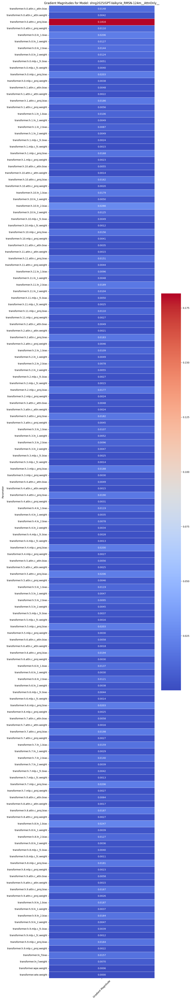



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__FFNonly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


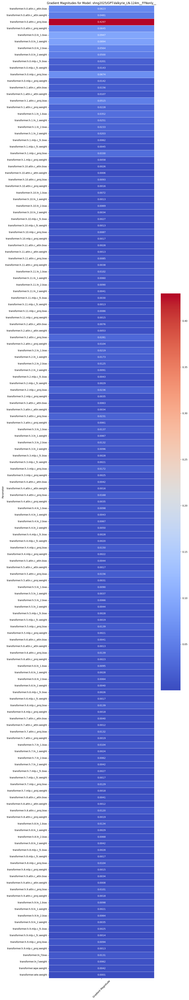



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


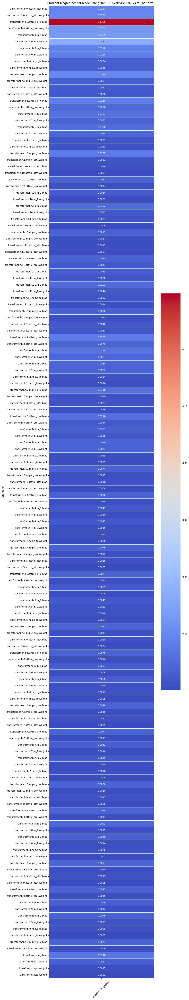



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


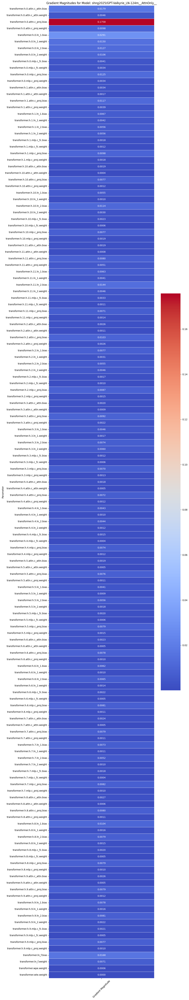



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


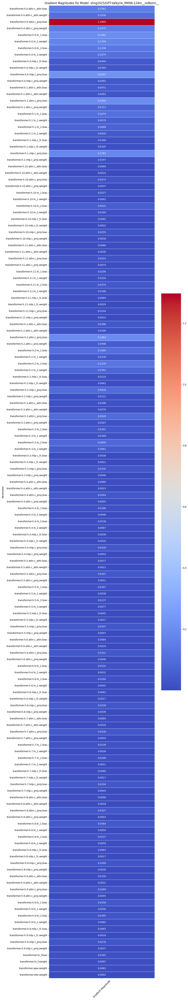



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


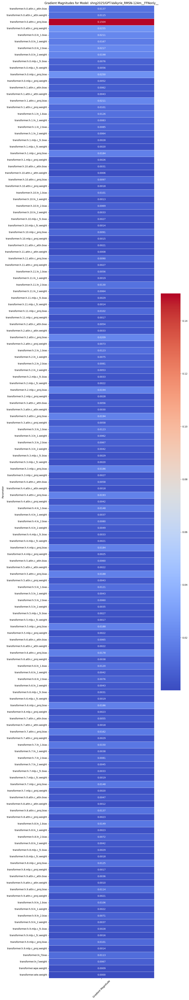



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__baseModel__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


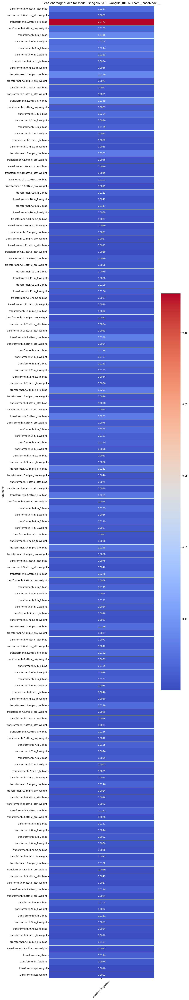



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__baseModel__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


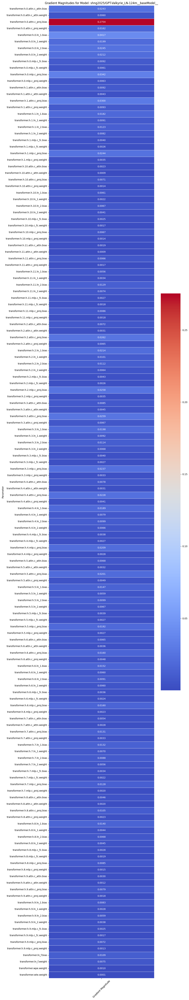

In [ ]:
from transformers import AutoModelForCausalLM, AutoTokenizer
import torch
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def calculate_gradient_magnitudes(model_name, prompt):
    # Initialize the model and tokenizer
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")

    # Enable gradient computation in training mode
    model.train()

    # Tokenize and encode the prompt
    inputs = tokenizer(prompt, return_tensors="pt")

    # Perform a forward pass and calculate the loss
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss

    # Perform a backward pass to calculate gradients
    loss.backward()

    # Collect gradient magnitudes
    gradients = {}
    for name, parameter in model.named_parameters():
        if parameter.grad is not None:
            gradients[name] = parameter.grad.abs().mean().item()

    return gradients

def visualize_gradients(gradients, model_name):
    # Convert gradients dictionary to DataFrame for visualization
    gradient_df = pd.DataFrame(list(gradients.items()), columns=['Parameter', 'Gradient Magnitude'])

    # Sort by Parameter name (optional)
    gradient_df.sort_values('Parameter', inplace=True)

    # Set up the matplotlib figure
    plt.figure(figsize=(10, len(gradient_df) / 2))

    # Draw the heatmap with 'sns.heatmap()'
    sns.heatmap(gradient_df.set_index('Parameter'), annot=True, fmt=".4f", cmap="coolwarm", cbar=True, linewidths=.5)

    # Add title and adjust plot as necessary
    plt.title(f'Gradient Magnitudes for Model: {model_name}')
    plt.xticks(rotation=45)
    plt.yticks(rotation=0)

    plt.show()

# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",

]

# Prompt to use for inference
prompt = "Once upon a time in a land far, far away"

# Compare gradient magnitudes for each model variant
for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    gradient_magnitudes = calculate_gradient_magnitudes(model_name, prompt)
    visualize_gradients(gradient_magnitudes, model_name)
    print("\n")


Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-41-eea45aaea636>:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


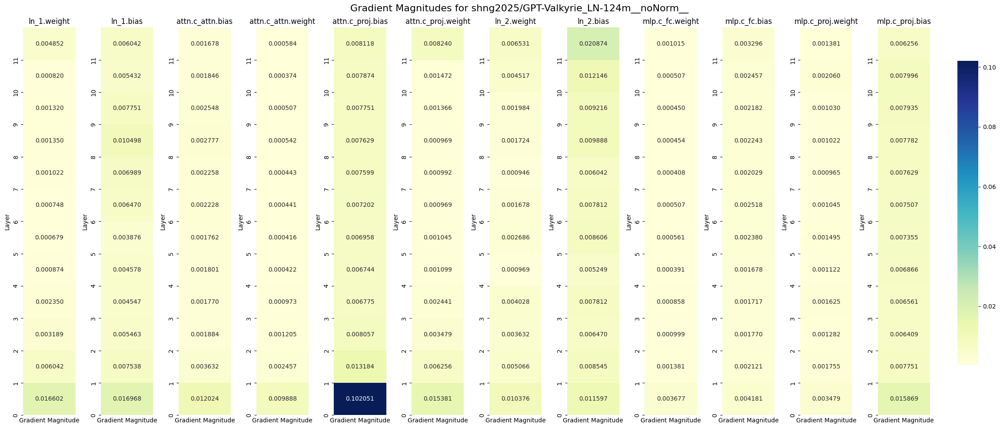



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-41-eea45aaea636>:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


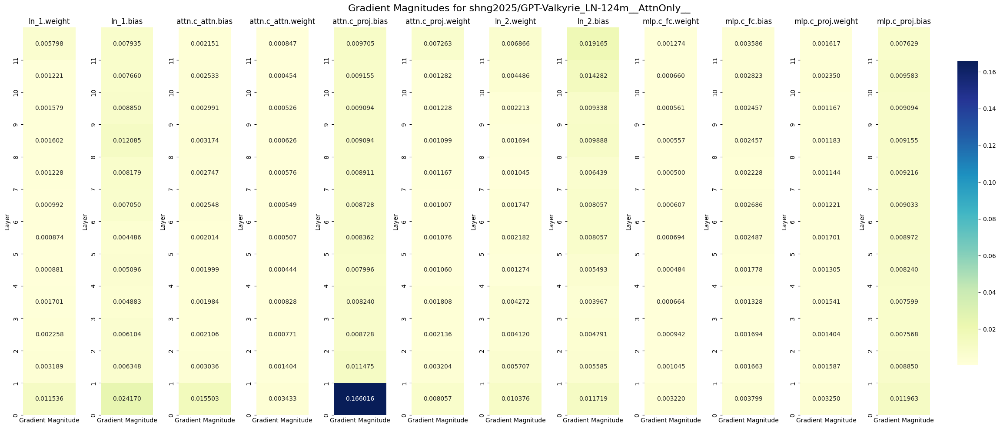



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__FFNonly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-41-eea45aaea636>:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


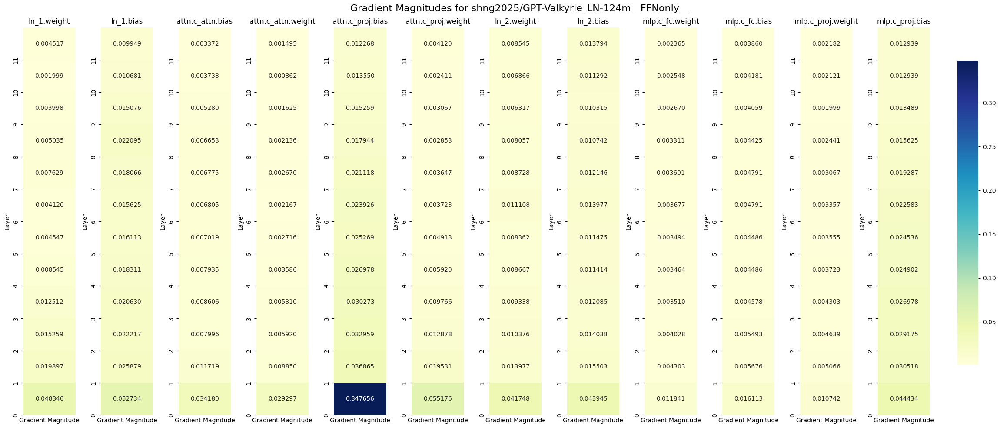



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__baseModel__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-41-eea45aaea636>:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


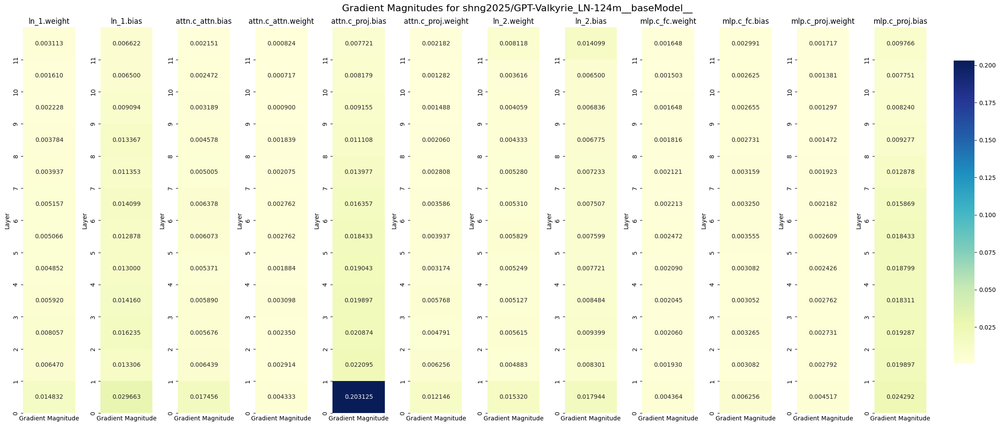



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-41-eea45aaea636>:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


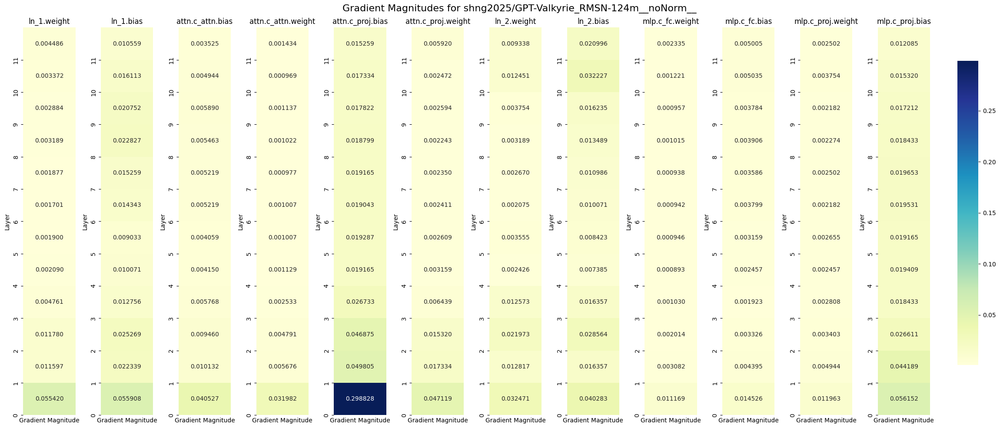



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-41-eea45aaea636>:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


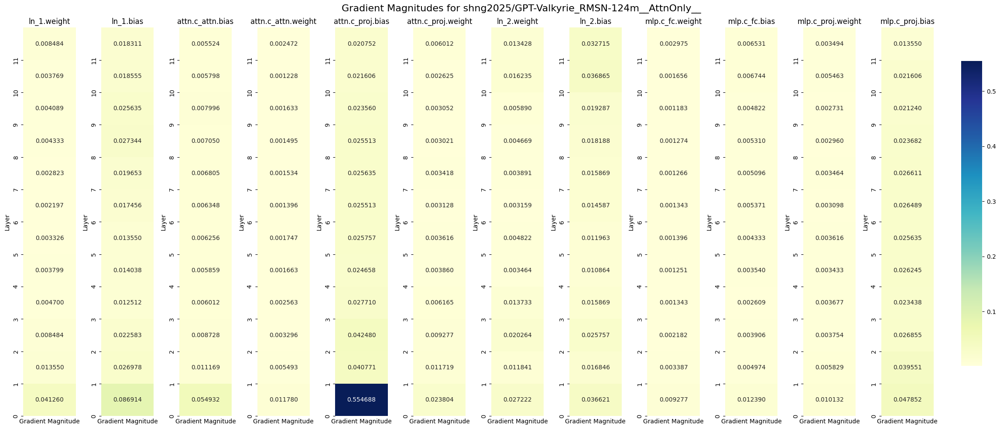



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-41-eea45aaea636>:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


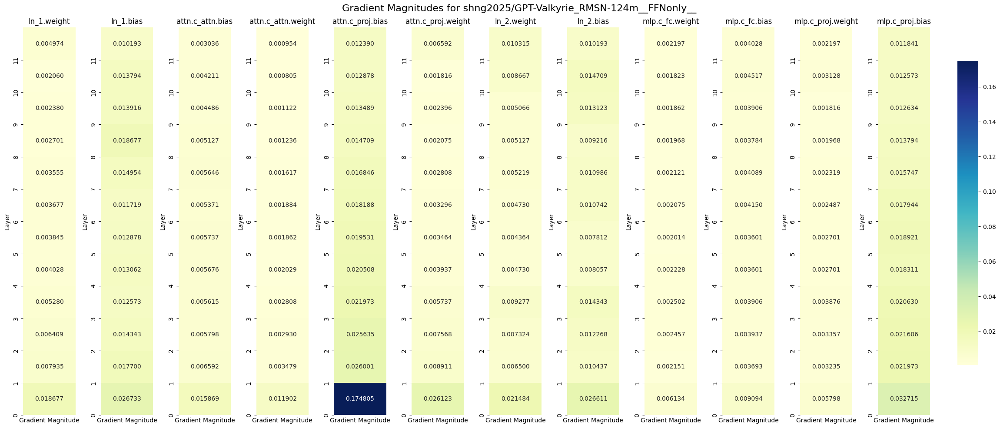



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__baseModel__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-41-eea45aaea636>:71: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


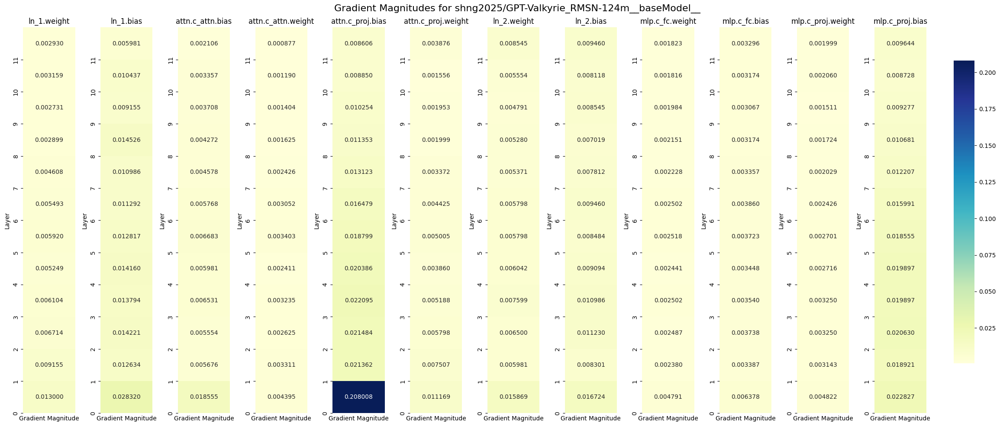

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def calculate_gradient_magnitudes(model_name, prompt):
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")
    tokenizer.pad_token = tokenizer.eos_token

    model.train()
    inputs = tokenizer(prompt, return_tensors="pt")
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss
    loss.backward()

    gradients = {}
    for name, parameter in model.named_parameters():
        if parameter.grad is not None:
            gradients[name] = parameter.grad.abs().mean().item()

    return gradients, model

def calculate_layer_gradients(model, gradients):
    layer_gradients = []
    for i, layer in enumerate(model.transformer.h):
        # Check if the layer uses RMSNorm
        uses_rmsnorm = hasattr(layer, 'rmsnorm')  # Adjust based on actual attribute used for RMSNorm

        layer_gradient = {
            'ln_1.weight': gradients.get(f'transformer.h.{i}.ln_1.weight', 0),
            'ln_1.bias': gradients.get(f'transformer.h.{i}.ln_1.bias', 0) if not uses_rmsnorm else 0,
            'attn.c_attn.bias': gradients.get(f'transformer.h.{i}.attn.c_attn.bias', 0),
            'attn.c_attn.weight': gradients.get(f'transformer.h.{i}.attn.c_attn.weight', 0),
            'attn.c_proj.bias': gradients.get(f'transformer.h.{i}.attn.c_proj.bias', 0),
            'attn.c_proj.weight': gradients.get(f'transformer.h.{i}.attn.c_proj.weight', 0),
            'ln_2.weight': gradients.get(f'transformer.h.{i}.ln_2.weight', 0),
            'ln_2.bias': gradients.get(f'transformer.h.{i}.ln_2.bias', 0) if not uses_rmsnorm else 0,
            'mlp.c_fc.weight': gradients.get(f'transformer.h.{i}.mlp.c_fc.weight', 0),
            'mlp.c_fc.bias': gradients.get(f'transformer.h.{i}.mlp.c_fc.bias', 0),
            'mlp.c_proj.weight': gradients.get(f'transformer.h.{i}.mlp.c_proj.weight', 0),
            'mlp.c_proj.bias': gradients.get(f'transformer.h.{i}.mlp.c_proj.bias', 0),
        }
        layer_gradients.append(layer_gradient)
    return layer_gradients

def visualize_layer_gradients(layer_gradients, model_name):
    num_layers = len(layer_gradients)
    num_components = len(layer_gradients[0])
    fig, axs = plt.subplots(1, num_components, figsize=(24, 10))
    fig.suptitle(f"Gradient Magnitudes for {model_name}", fontsize=16)

    # Calculate global min and max for consistent color scale
    all_gradients = [grad for layer in layer_gradients for grad in layer.values()]
    vmin, vmax = min(all_gradients), max(all_gradients)

    # Create a single colorbar for all subplots
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]

    for i, component in enumerate(layer_gradients[0].keys()):
        component_gradients = [[layer_gradient[component]] for layer_gradient in layer_gradients]
        sns.heatmap(component_gradients, annot=True, fmt=".6f", cmap="YlGnBu",
                    ax=axs[i], cbar=i == 0, cbar_ax=None if i else cbar_ax,
                    vmin=vmin, vmax=vmax)
        axs[i].set_title(component)
        axs[i].set_xlabel("Gradient Magnitude")
        axs[i].set_ylabel("Layer")
        axs[i].set_xticks([])
        axs[i].set_yticks(range(num_layers))
        axs[i].set_yticklabels(range(num_layers))
        axs[i].invert_yaxis()

    plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar
    plt.show()

# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
]

prompt = "Once upon a time in a land far, far away"

for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    gradients, model = calculate_gradient_magnitudes(model_name, prompt)
    layer_gradients = calculate_layer_gradients(model, gradients)
    visualize_layer_gradients(layer_gradients, model_name)
    print("\n")

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-42-88c5060f521f>:72: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


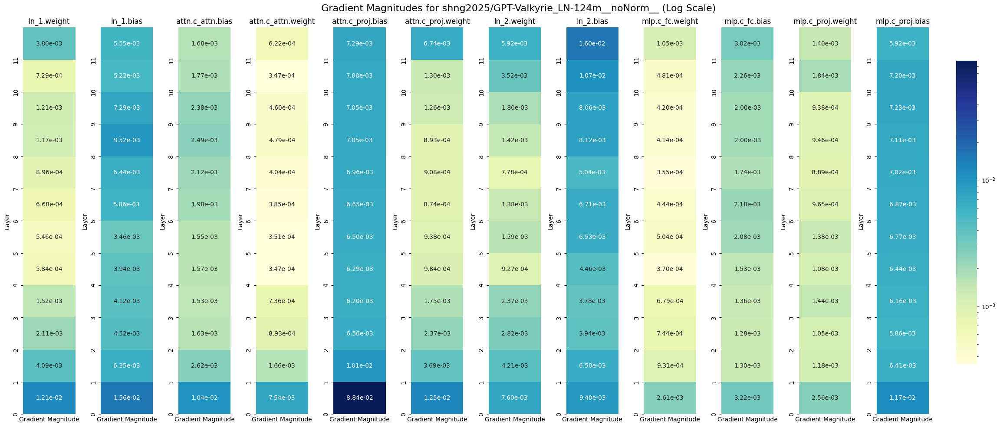



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-42-88c5060f521f>:72: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


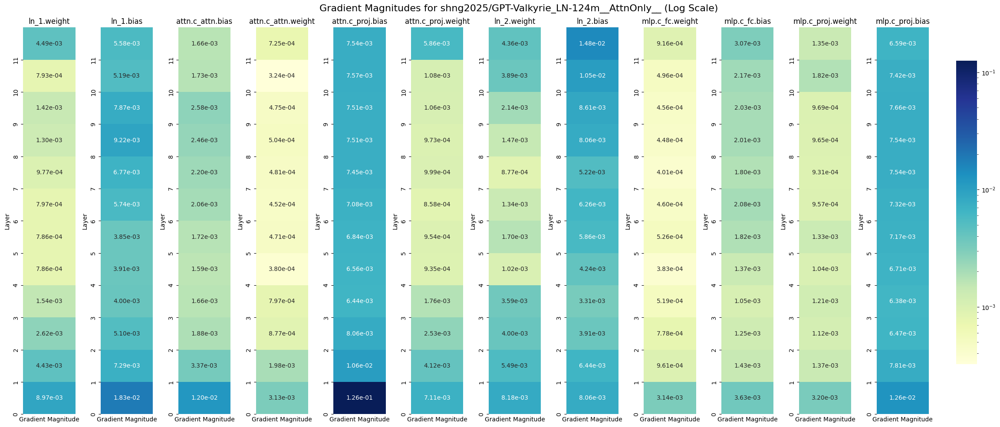



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__FFNonly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-42-88c5060f521f>:72: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


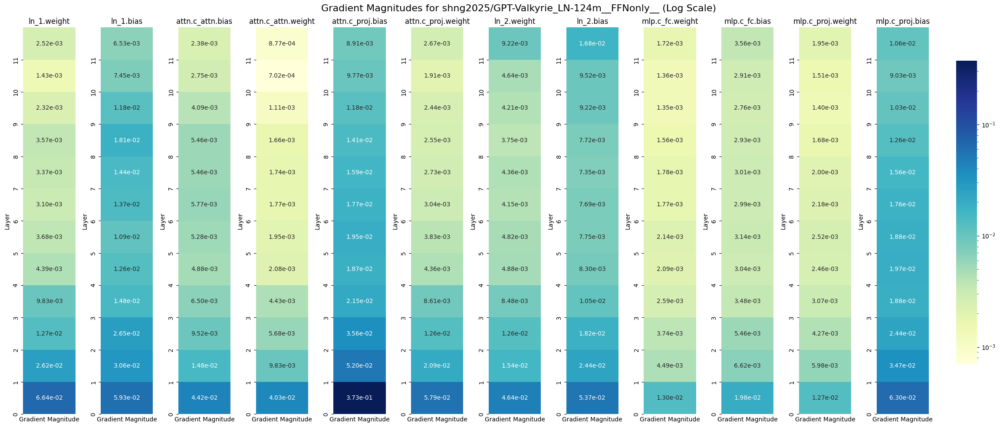



Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__baseModel__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-42-88c5060f521f>:72: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


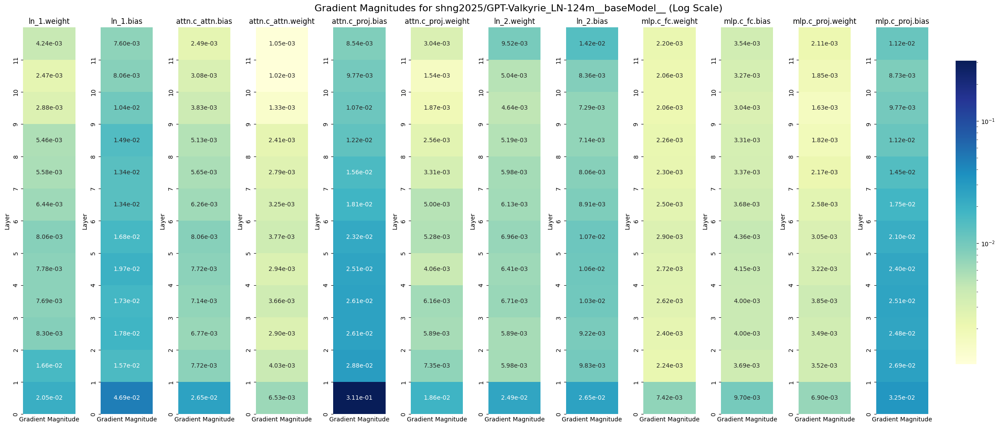



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-42-88c5060f521f>:72: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


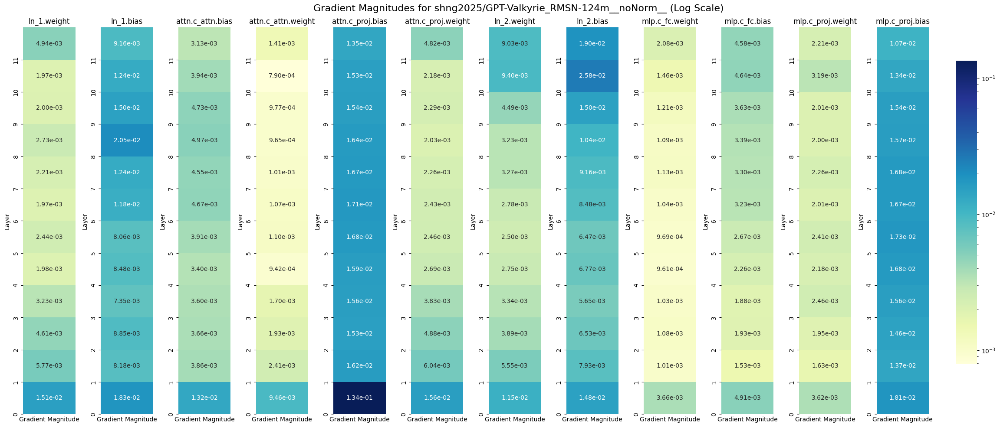



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-42-88c5060f521f>:72: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


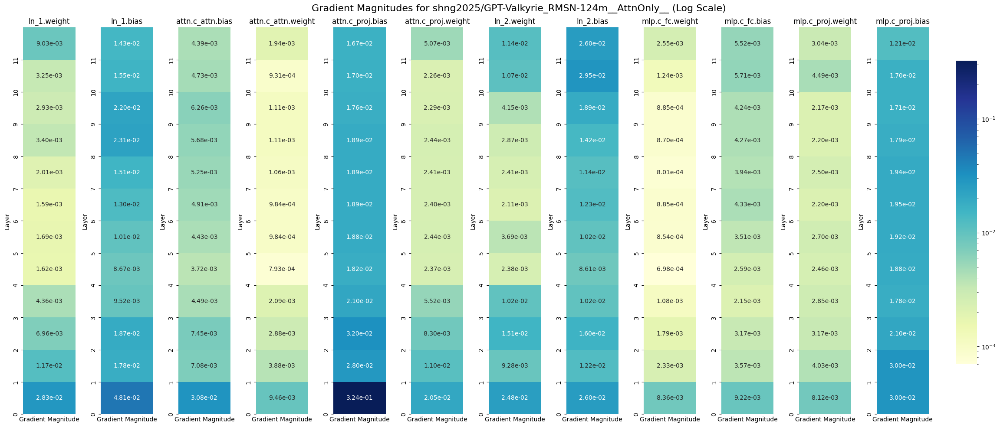



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-42-88c5060f521f>:72: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


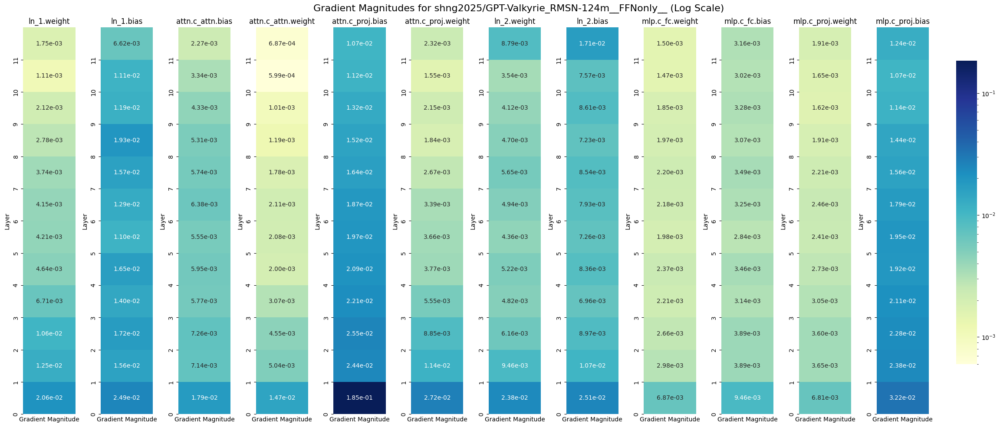



Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__baseModel__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-42-88c5060f521f>:72: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


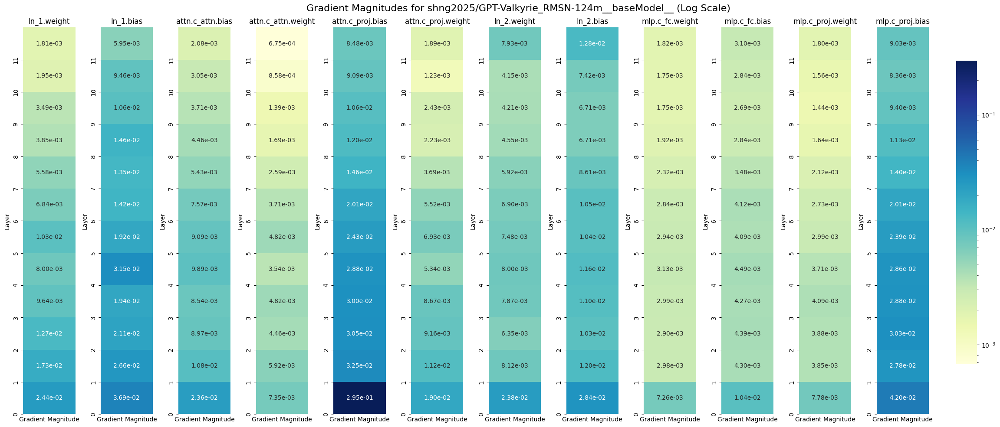

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import LogNorm

def calculate_gradient_magnitudes(model_name, prompt):
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")
    tokenizer.pad_token = tokenizer.eos_token

    model.train()
    inputs = tokenizer(prompt, return_tensors="pt")
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss
    loss.backward()

    gradients = {}
    for name, parameter in model.named_parameters():
        if parameter.grad is not None:
            gradients[name] = parameter.grad.abs().mean().item()

    return gradients, model

def calculate_layer_gradients(model, gradients):
    layer_gradients = []
    for i, layer in enumerate(model.transformer.h):
        # Check if the layer uses RMSNorm
        uses_rmsnorm = hasattr(layer, 'rmsnorm')  # Adjust based on actual attribute used for RMSNorm

        layer_gradient = {
            'ln_1.weight': gradients.get(f'transformer.h.{i}.ln_1.weight', 0),
            'ln_1.bias': gradients.get(f'transformer.h.{i}.ln_1.bias', 0) if not uses_rmsnorm else 0,
            'attn.c_attn.bias': gradients.get(f'transformer.h.{i}.attn.c_attn.bias', 0),
            'attn.c_attn.weight': gradients.get(f'transformer.h.{i}.attn.c_attn.weight', 0),
            'attn.c_proj.bias': gradients.get(f'transformer.h.{i}.attn.c_proj.bias', 0),
            'attn.c_proj.weight': gradients.get(f'transformer.h.{i}.attn.c_proj.weight', 0),
            'ln_2.weight': gradients.get(f'transformer.h.{i}.ln_2.weight', 0),
            'ln_2.bias': gradients.get(f'transformer.h.{i}.ln_2.bias', 0) if not uses_rmsnorm else 0,
            'mlp.c_fc.weight': gradients.get(f'transformer.h.{i}.mlp.c_fc.weight', 0),
            'mlp.c_fc.bias': gradients.get(f'transformer.h.{i}.mlp.c_fc.bias', 0),
            'mlp.c_proj.weight': gradients.get(f'transformer.h.{i}.mlp.c_proj.weight', 0),
            'mlp.c_proj.bias': gradients.get(f'transformer.h.{i}.mlp.c_proj.bias', 0),
        }
        layer_gradients.append(layer_gradient)
    return layer_gradients

def visualize_layer_gradients(layer_gradients, model_name):
    num_layers = len(layer_gradients)
    num_components = len(layer_gradients[0])
    fig, axs = plt.subplots(1, num_components, figsize=(24, 10))
    fig.suptitle(f"Gradient Magnitudes for {model_name} (Log Scale)", fontsize=16)

    # Calculate global min and max for consistent color scale
    all_gradients = [grad for layer in layer_gradients for grad in layer.values()]
    vmin, vmax = max(min(all_gradients), 1e-10), max(all_gradients)  # Avoid log(0)

    # Create a single colorbar for all subplots
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]

    for i, component in enumerate(layer_gradients[0].keys()):
        component_gradients = [[layer_gradient[component]] for layer_gradient in layer_gradients]
        sns.heatmap(component_gradients, annot=True, fmt=".2e", cmap="YlGnBu",
                    ax=axs[i], cbar=i == 0, cbar_ax=None if i else cbar_ax,
                    norm=LogNorm(vmin=vmin, vmax=vmax))
        axs[i].set_title(component)
        axs[i].set_xlabel("Gradient Magnitude")
        axs[i].set_ylabel("Layer")
        axs[i].set_xticks([])
        axs[i].set_yticks(range(num_layers))
        axs[i].set_yticklabels(range(num_layers))
        axs[i].invert_yaxis()

    plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar
    plt.show()

# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
]

prompt = "Once upon a time in a land far, far away"

for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    gradients, model = calculate_gradient_magnitudes(model_name, prompt)
    layer_gradients = calculate_layer_gradients(model, gradients)
    visualize_layer_gradients(layer_gradients, model_name)
    print("\n")

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__
Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__FFNonly__
Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__baseModel__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__noNorm__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__baseModel__


<ipython-input-43-23fffbd29dd9>:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


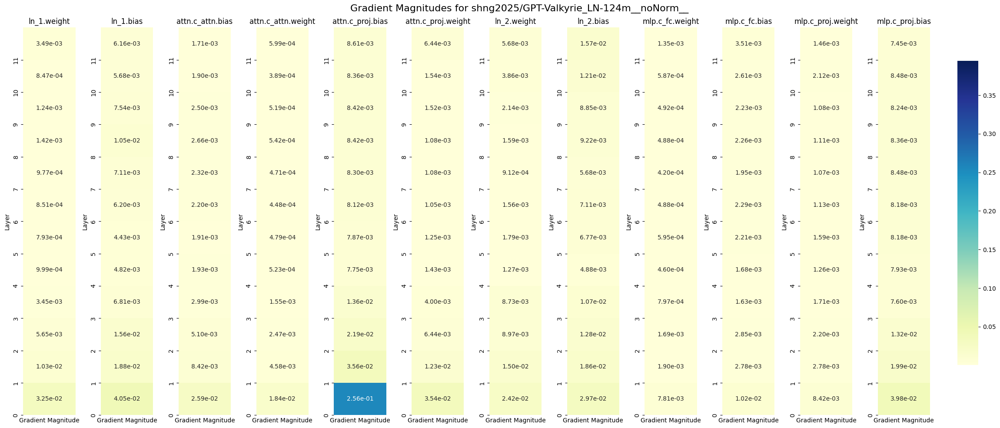

<ipython-input-43-23fffbd29dd9>:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


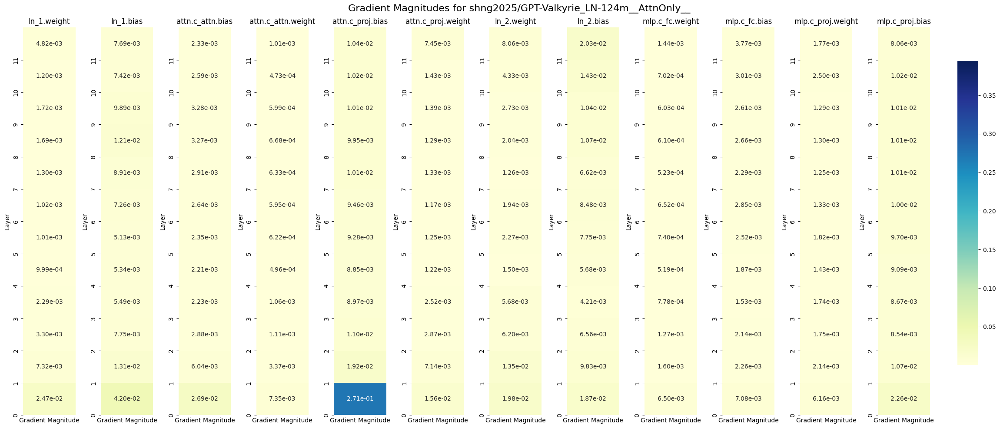

<ipython-input-43-23fffbd29dd9>:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


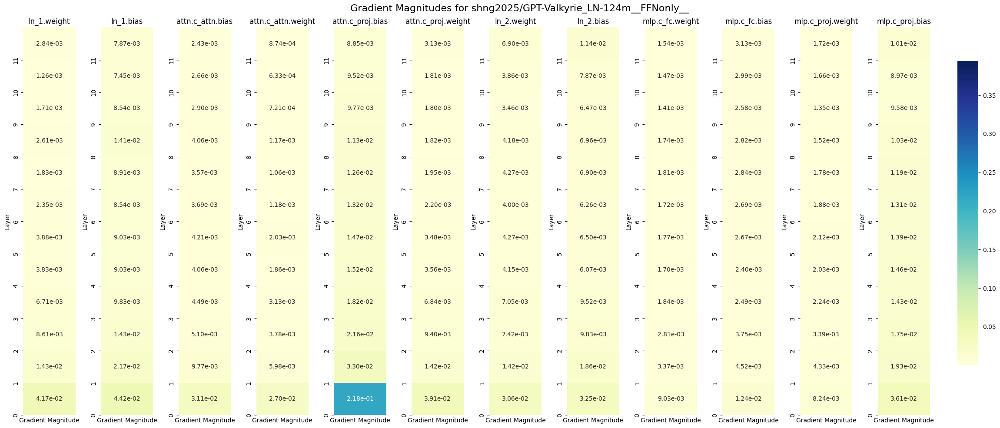

<ipython-input-43-23fffbd29dd9>:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


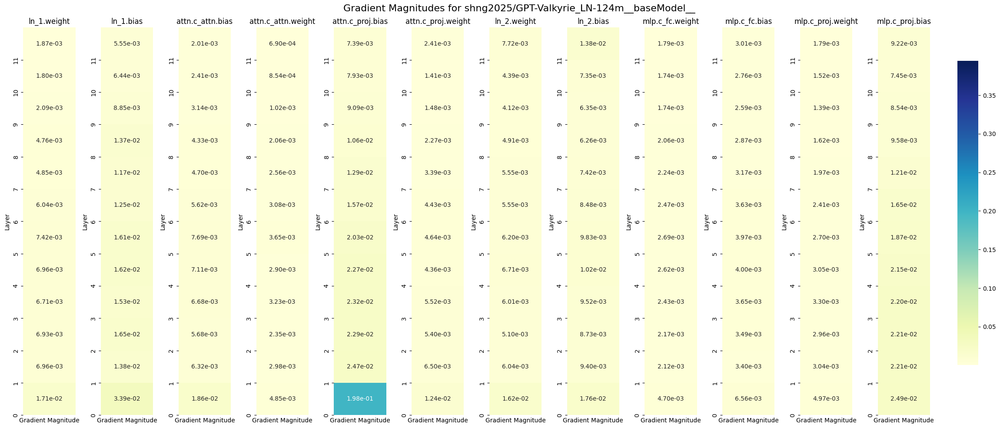

<ipython-input-43-23fffbd29dd9>:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


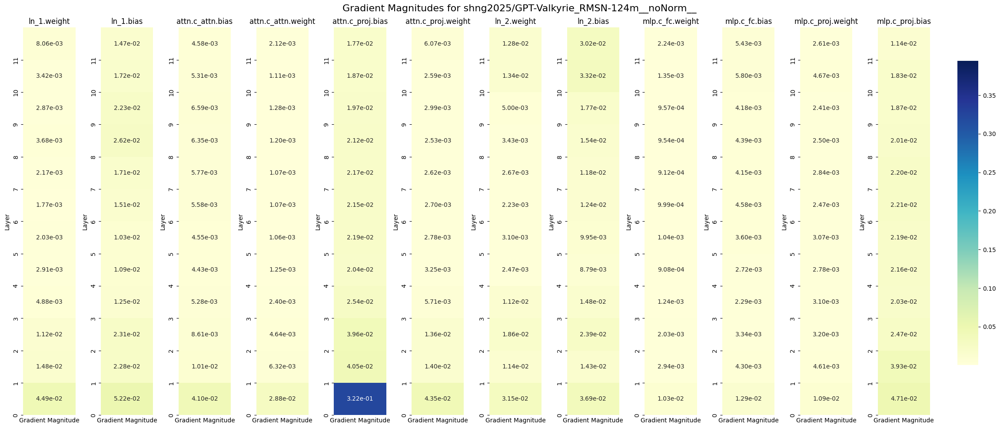

<ipython-input-43-23fffbd29dd9>:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


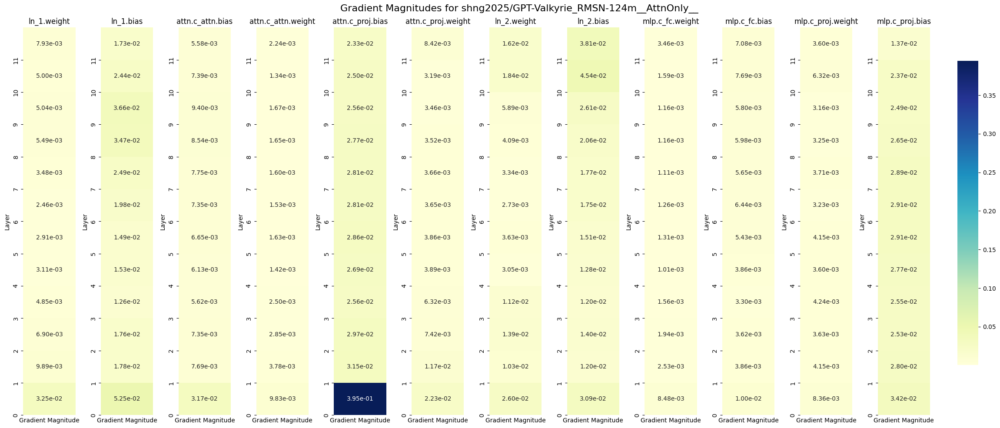

<ipython-input-43-23fffbd29dd9>:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


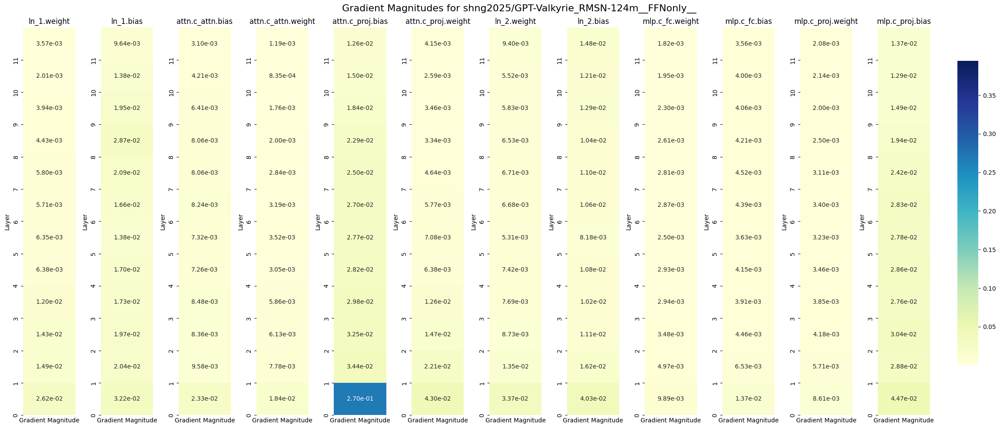

<ipython-input-43-23fffbd29dd9>:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


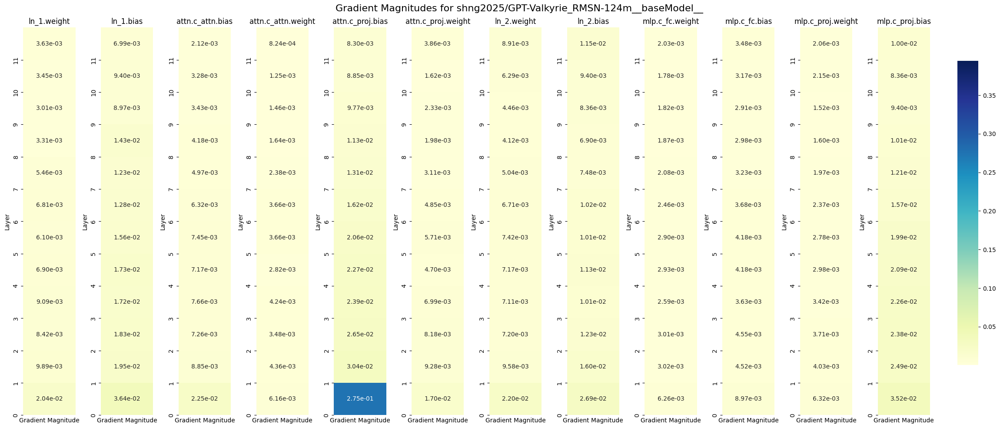

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def calculate_gradient_magnitudes(model_name, prompt):
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")
    tokenizer.pad_token = tokenizer.eos_token

    model.train()
    inputs = tokenizer(prompt, return_tensors="pt")
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss
    loss.backward()

    gradients = {}
    for name, parameter in model.named_parameters():
        if parameter.grad is not None:
            gradients[name] = parameter.grad.abs().mean().item()

    return gradients, model

def calculate_layer_gradients(model, gradients):
    layer_gradients = []
    for i, layer in enumerate(model.transformer.h):
        # Check if the layer uses RMSNorm
        uses_rmsnorm = hasattr(layer, 'rmsnorm')  # Adjust based on actual attribute used for RMSNorm

        layer_gradient = {
            'ln_1.weight': gradients.get(f'transformer.h.{i}.ln_1.weight', 0),
            'ln_1.bias': gradients.get(f'transformer.h.{i}.ln_1.bias', 0) if not uses_rmsnorm else 0,
            'attn.c_attn.bias': gradients.get(f'transformer.h.{i}.attn.c_attn.bias', 0),
            'attn.c_attn.weight': gradients.get(f'transformer.h.{i}.attn.c_attn.weight', 0),
            'attn.c_proj.bias': gradients.get(f'transformer.h.{i}.attn.c_proj.bias', 0),
            'attn.c_proj.weight': gradients.get(f'transformer.h.{i}.attn.c_proj.weight', 0),
            'ln_2.weight': gradients.get(f'transformer.h.{i}.ln_2.weight', 0),
            'ln_2.bias': gradients.get(f'transformer.h.{i}.ln_2.bias', 0) if not uses_rmsnorm else 0,
            'mlp.c_fc.weight': gradients.get(f'transformer.h.{i}.mlp.c_fc.weight', 0),
            'mlp.c_fc.bias': gradients.get(f'transformer.h.{i}.mlp.c_fc.bias', 0),
            'mlp.c_proj.weight': gradients.get(f'transformer.h.{i}.mlp.c_proj.weight', 0),
            'mlp.c_proj.bias': gradients.get(f'transformer.h.{i}.mlp.c_proj.bias', 0),
        }
        layer_gradients.append(layer_gradient)
    return layer_gradients

def visualize_layer_gradients(layer_gradients, model_name, vmin, vmax):
    num_layers = len(layer_gradients)
    num_components = len(layer_gradients[0])
    fig, axs = plt.subplots(1, num_components, figsize=(24, 10))
    fig.suptitle(f"Gradient Magnitudes for {model_name}", fontsize=16)

    # Create a single colorbar for all subplots
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]

    for i, component in enumerate(layer_gradients[0].keys()):
        component_gradients = [[layer_gradient[component]] for layer_gradient in layer_gradients]
        sns.heatmap(component_gradients, annot=True, fmt=".2e", cmap="YlGnBu",
                    ax=axs[i], cbar=i == 0, cbar_ax=None if i else cbar_ax,
                    vmin=vmin, vmax=vmax)
        axs[i].set_title(component)
        axs[i].set_xlabel("Gradient Magnitude")
        axs[i].set_ylabel("Layer")
        axs[i].set_xticks([])
        axs[i].set_yticks(range(num_layers))
        axs[i].set_yticklabels(range(num_layers))
        axs[i].invert_yaxis()

    plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar
    plt.show()

# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
]

prompt = "Once upon a time in a land far, far away"

# First, calculate gradients for all models
all_layer_gradients = []
for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    gradients, model = calculate_gradient_magnitudes(model_name, prompt)
    layer_gradients = calculate_layer_gradients(model, gradients)
    all_layer_gradients.append(layer_gradients)

# Calculate global min and max across all models
all_gradients = [grad for model_gradients in all_layer_gradients for layer in model_gradients for grad in layer.values()]
vmin, vmax = min(all_gradients), max(all_gradients)

# Now visualize with the global min and max
for model_name, layer_gradients in zip(model_variants, all_layer_gradients):
    visualize_layer_gradients(layer_gradients, model_name, vmin, vmax)
    print("\n")

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__
Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__FFNonly__
Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__baseModel__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__noNorm__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__baseModel__


<ipython-input-44-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


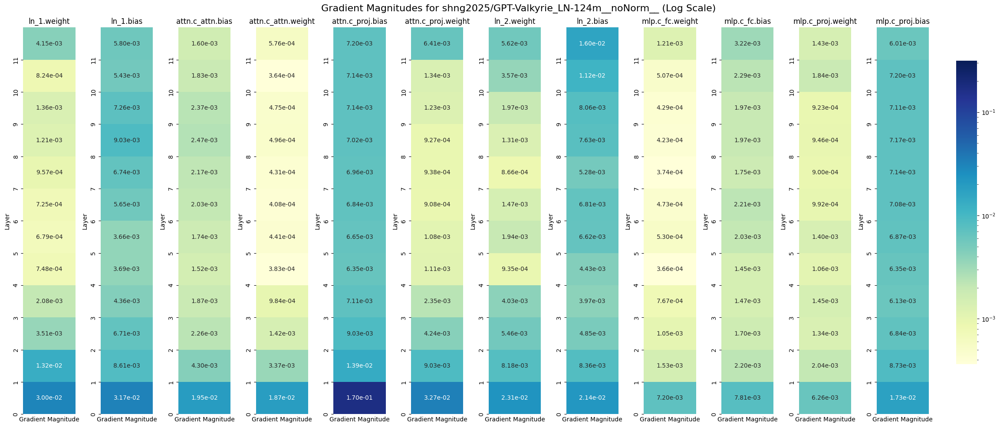

<ipython-input-44-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


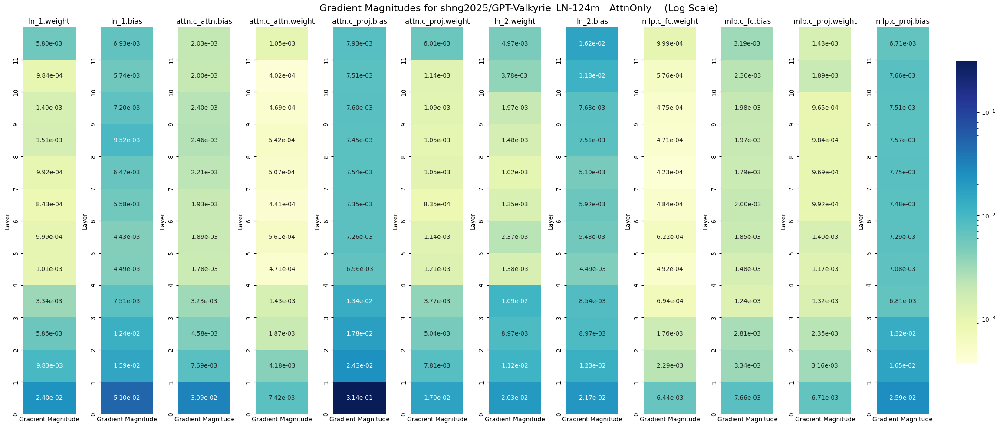

<ipython-input-44-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


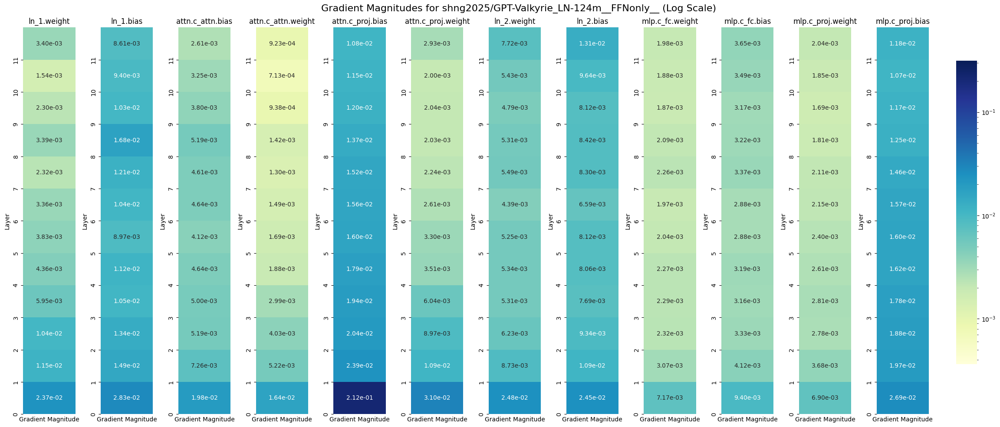

<ipython-input-44-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


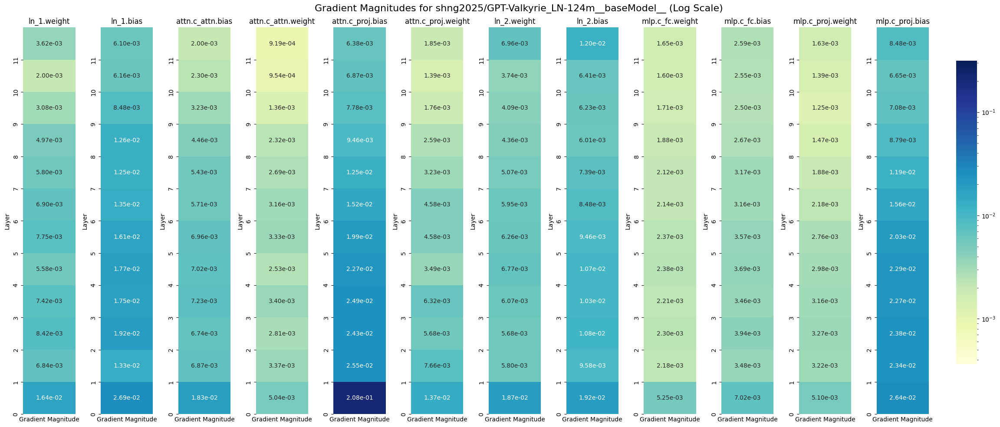

<ipython-input-44-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


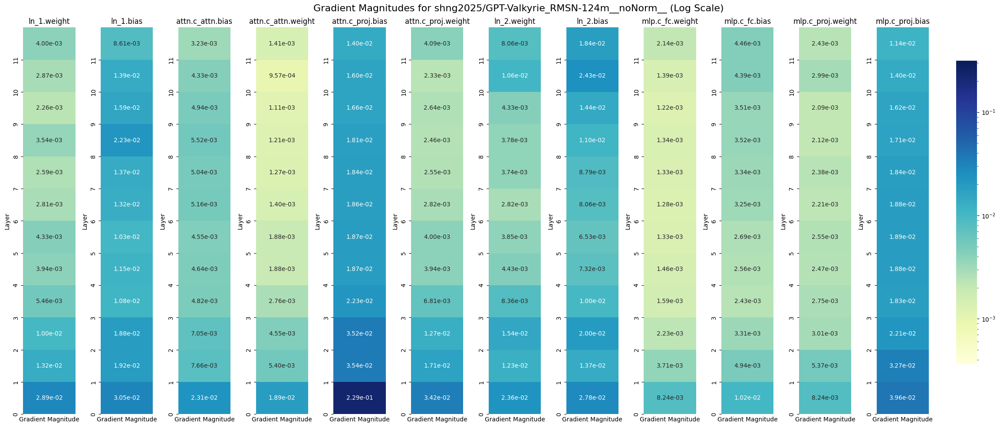

<ipython-input-44-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


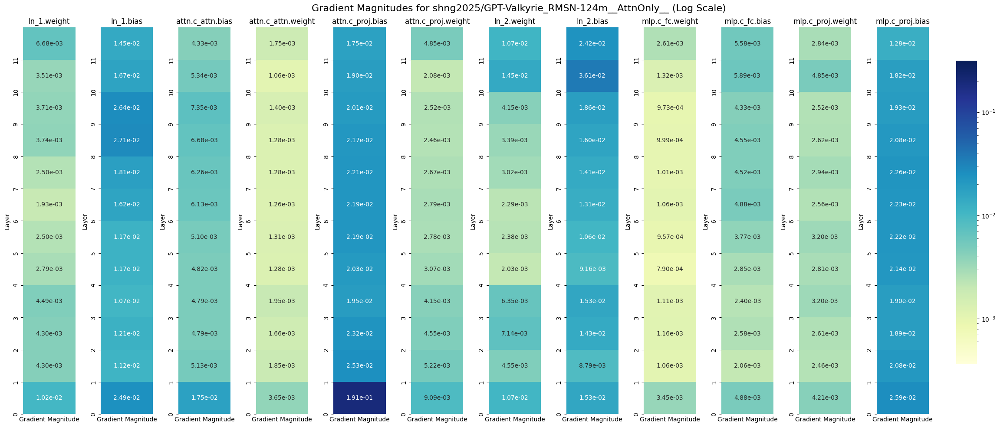

<ipython-input-44-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


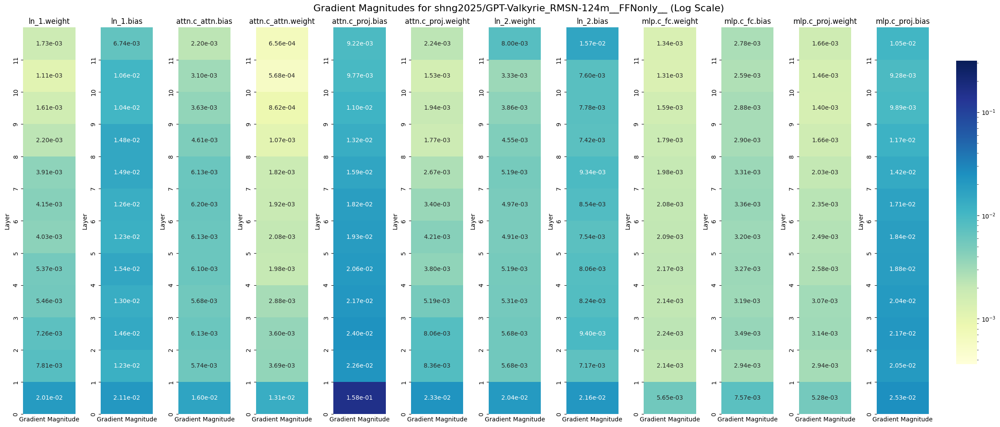

<ipython-input-44-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


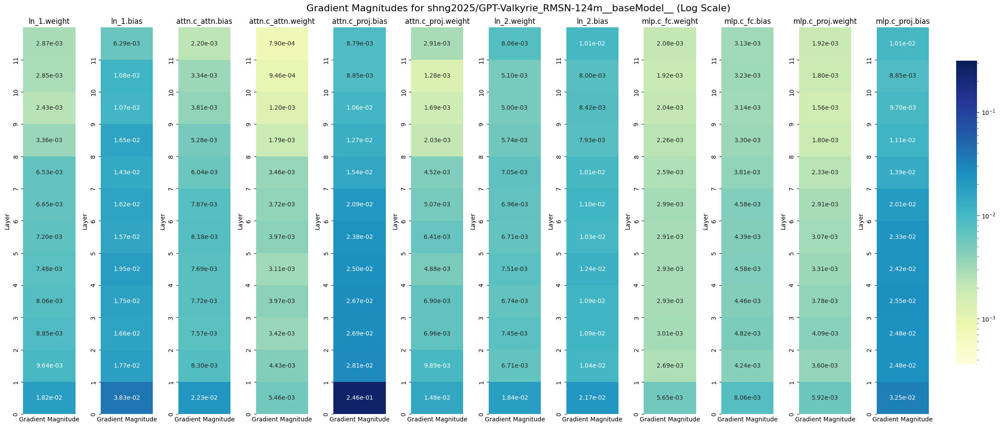

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import LogNorm

def calculate_gradient_magnitudes(model_name, prompt):
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")
    tokenizer.pad_token = tokenizer.eos_token

    model.train()
    inputs = tokenizer(prompt, return_tensors="pt")
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss
    loss.backward()

    gradients = {}
    for name, parameter in model.named_parameters():
        if parameter.grad is not None:
            gradients[name] = parameter.grad.abs().mean().item()

    return gradients, model

def calculate_layer_gradients(model, gradients):
    layer_gradients = []
    for i, layer in enumerate(model.transformer.h):
        # Check if the layer uses RMSNorm
        uses_rmsnorm = hasattr(layer, 'rmsnorm')  # Adjust based on actual attribute used for RMSNorm

        layer_gradient = {
            'ln_1.weight': gradients.get(f'transformer.h.{i}.ln_1.weight', 0),
            'ln_1.bias': gradients.get(f'transformer.h.{i}.ln_1.bias', 0) if not uses_rmsnorm else 0,
            'attn.c_attn.bias': gradients.get(f'transformer.h.{i}.attn.c_attn.bias', 0),
            'attn.c_attn.weight': gradients.get(f'transformer.h.{i}.attn.c_attn.weight', 0),
            'attn.c_proj.bias': gradients.get(f'transformer.h.{i}.attn.c_proj.bias', 0),
            'attn.c_proj.weight': gradients.get(f'transformer.h.{i}.attn.c_proj.weight', 0),
            'ln_2.weight': gradients.get(f'transformer.h.{i}.ln_2.weight', 0),
            'ln_2.bias': gradients.get(f'transformer.h.{i}.ln_2.bias', 0) if not uses_rmsnorm else 0,
            'mlp.c_fc.weight': gradients.get(f'transformer.h.{i}.mlp.c_fc.weight', 0),
            'mlp.c_fc.bias': gradients.get(f'transformer.h.{i}.mlp.c_fc.bias', 0),
            'mlp.c_proj.weight': gradients.get(f'transformer.h.{i}.mlp.c_proj.weight', 0),
            'mlp.c_proj.bias': gradients.get(f'transformer.h.{i}.mlp.c_proj.bias', 0),
        }
        layer_gradients.append(layer_gradient)
    return layer_gradients

def visualize_layer_gradients(layer_gradients, model_name, vmin, vmax):
    num_layers = len(layer_gradients)
    num_components = len(layer_gradients[0])
    fig, axs = plt.subplots(1, num_components, figsize=(24, 10))
    fig.suptitle(f"Gradient Magnitudes for {model_name} (Log Scale)", fontsize=16)

    # Create a single colorbar for all subplots
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]

    for i, component in enumerate(layer_gradients[0].keys()):
        component_gradients = [[layer_gradient[component]] for layer_gradient in layer_gradients]
        sns.heatmap(component_gradients, annot=True, fmt=".2e", cmap="YlGnBu",
                    ax=axs[i], cbar=i == 0, cbar_ax=None if i else cbar_ax,
                    norm=LogNorm(vmin=vmin, vmax=vmax))
        axs[i].set_title(component)
        axs[i].set_xlabel("Gradient Magnitude")
        axs[i].set_ylabel("Layer")
        axs[i].set_xticks([])
        axs[i].set_yticks(range(num_layers))
        axs[i].set_yticklabels(range(num_layers))
        axs[i].invert_yaxis()

    plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar
    plt.show()

# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
]

prompt = "Once upon a time in a land far, far away"

# First, calculate gradients for all models
all_layer_gradients = []
for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    gradients, model = calculate_gradient_magnitudes(model_name, prompt)
    layer_gradients = calculate_layer_gradients(model, gradients)
    all_layer_gradients.append(layer_gradients)

# Calculate global min and max across all models
all_gradients = [grad for model_gradients in all_layer_gradients for layer in model_gradients for grad in layer.values()]
vmin, vmax = max(min(all_gradients), 1e-10), max(all_gradients)  # Avoid log(0)

# Now visualize with the global min and max
for model_name, layer_gradients in zip(model_variants, all_layer_gradients):
    visualize_layer_gradients(layer_gradients, model_name, vmin, vmax)
    print("\n")

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__
Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__FFNonly__
Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__baseModel__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__noNorm__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__baseModel__


<ipython-input-45-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


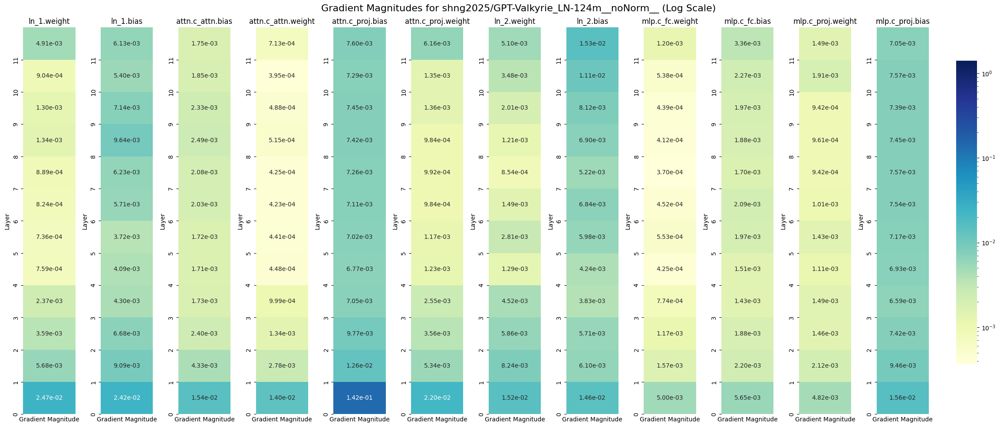

<ipython-input-45-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


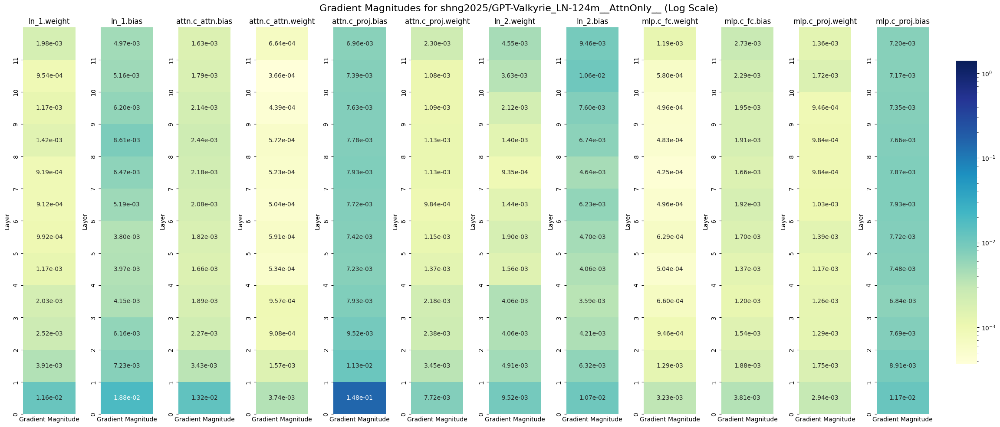

<ipython-input-45-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


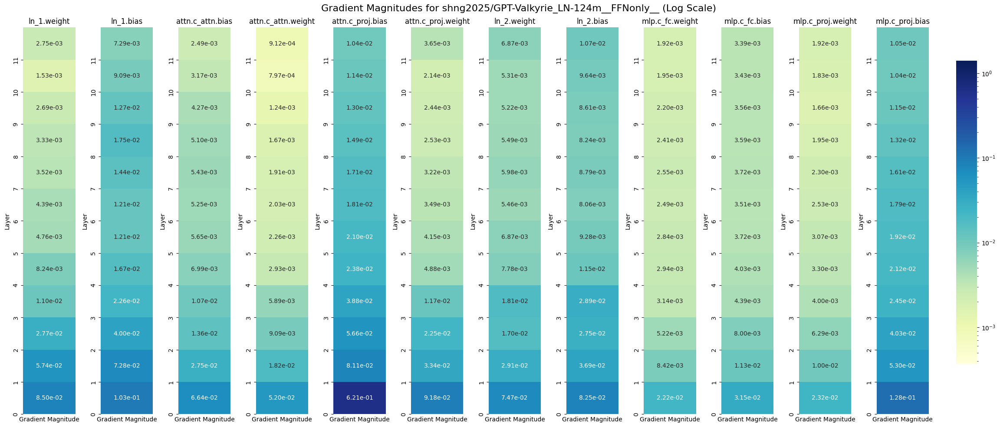

<ipython-input-45-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


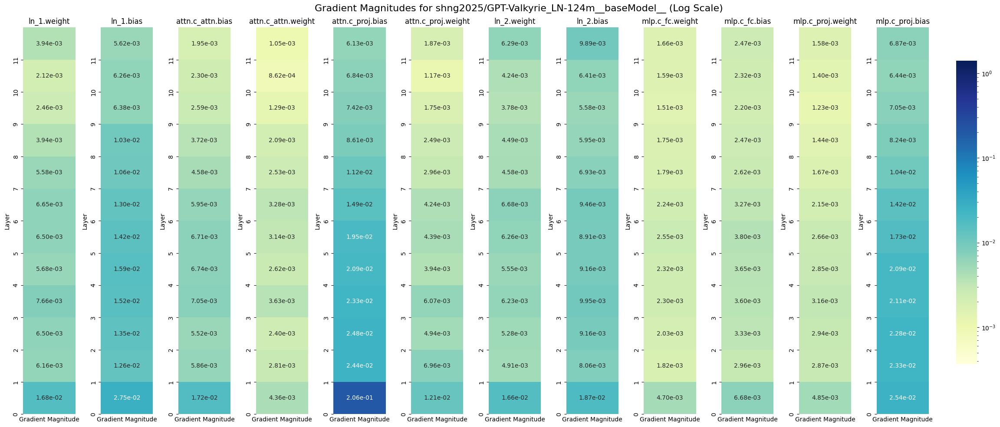

<ipython-input-45-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


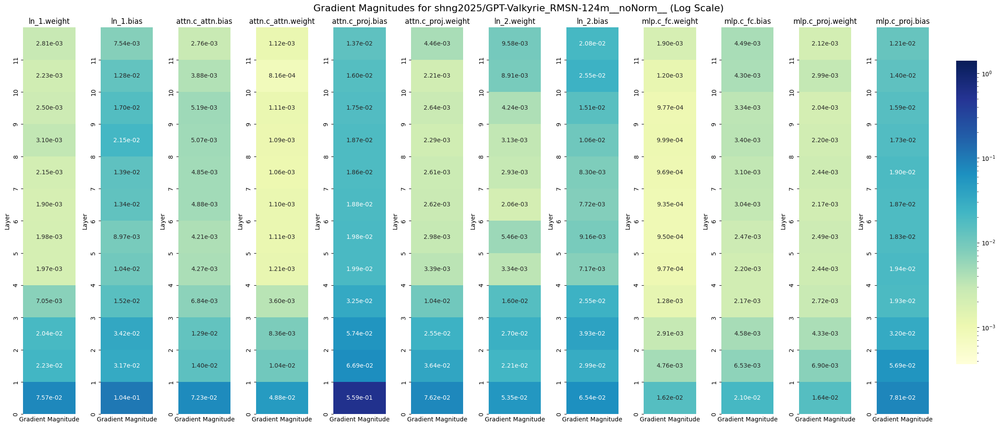

<ipython-input-45-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


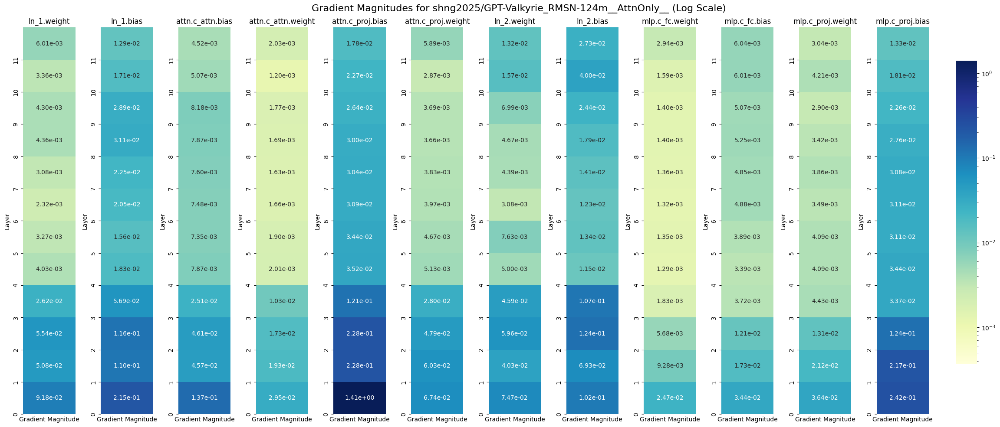

<ipython-input-45-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


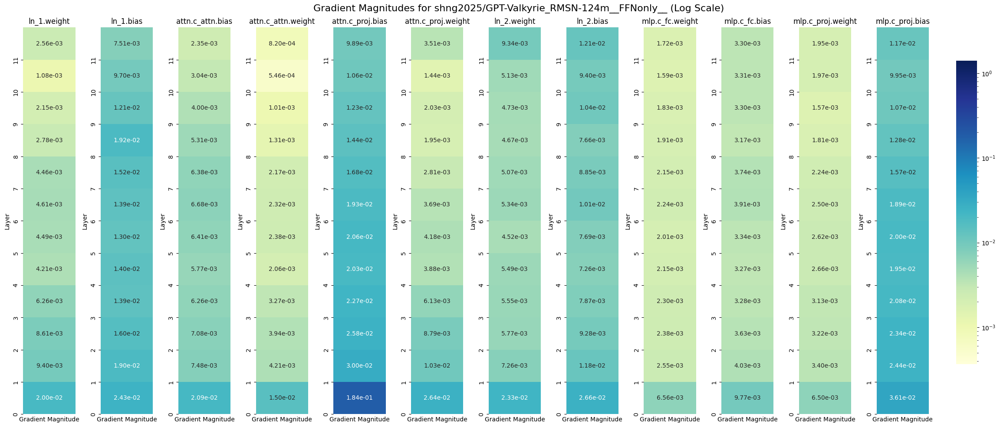

<ipython-input-45-4e5dc9b25f2a>:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar


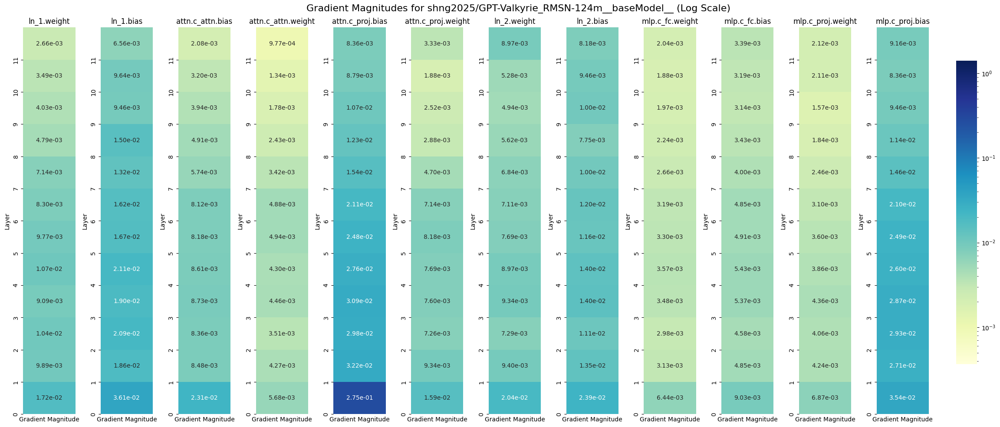

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import LogNorm

def calculate_gradient_magnitudes(model_name, prompt):
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")
    tokenizer.pad_token = tokenizer.eos_token

    model.train()
    inputs = tokenizer(prompt, return_tensors="pt")
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss
    loss.backward()

    gradients = {}
    for name, parameter in model.named_parameters():
        if parameter.grad is not None:
            gradients[name] = parameter.grad.abs().mean().item()

    return gradients, model

def calculate_layer_gradients(model, gradients):
    layer_gradients = []
    for i, layer in enumerate(model.transformer.h):
        # Check if the layer uses RMSNorm
        uses_rmsnorm = hasattr(layer, 'rmsnorm')  # Adjust based on actual attribute used for RMSNorm

        layer_gradient = {
            'ln_1.weight': gradients.get(f'transformer.h.{i}.ln_1.weight', 0),
            'ln_1.bias': gradients.get(f'transformer.h.{i}.ln_1.bias', 0) if not uses_rmsnorm else 0,
            'attn.c_attn.bias': gradients.get(f'transformer.h.{i}.attn.c_attn.bias', 0),
            'attn.c_attn.weight': gradients.get(f'transformer.h.{i}.attn.c_attn.weight', 0),
            'attn.c_proj.bias': gradients.get(f'transformer.h.{i}.attn.c_proj.bias', 0),
            'attn.c_proj.weight': gradients.get(f'transformer.h.{i}.attn.c_proj.weight', 0),
            'ln_2.weight': gradients.get(f'transformer.h.{i}.ln_2.weight', 0),
            'ln_2.bias': gradients.get(f'transformer.h.{i}.ln_2.bias', 0) if not uses_rmsnorm else 0,
            'mlp.c_fc.weight': gradients.get(f'transformer.h.{i}.mlp.c_fc.weight', 0),
            'mlp.c_fc.bias': gradients.get(f'transformer.h.{i}.mlp.c_fc.bias', 0),
            'mlp.c_proj.weight': gradients.get(f'transformer.h.{i}.mlp.c_proj.weight', 0),
            'mlp.c_proj.bias': gradients.get(f'transformer.h.{i}.mlp.c_proj.bias', 0),
        }
        layer_gradients.append(layer_gradient)
    return layer_gradients

def visualize_layer_gradients(layer_gradients, model_name, vmin, vmax):
    num_layers = len(layer_gradients)
    num_components = len(layer_gradients[0])
    fig, axs = plt.subplots(1, num_components, figsize=(24, 10))
    fig.suptitle(f"Gradient Magnitudes for {model_name} (Log Scale)", fontsize=16)

    # Create a single colorbar for all subplots
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]

    for i, component in enumerate(layer_gradients[0].keys()):
        component_gradients = [[layer_gradient[component]] for layer_gradient in layer_gradients]
        sns.heatmap(component_gradients, annot=True, fmt=".2e", cmap="YlGnBu",
                    ax=axs[i], cbar=i == 0, cbar_ax=None if i else cbar_ax,
                    norm=LogNorm(vmin=vmin, vmax=vmax))
        axs[i].set_title(component)
        axs[i].set_xlabel("Gradient Magnitude")
        axs[i].set_ylabel("Layer")
        axs[i].set_xticks([])
        axs[i].set_yticks(range(num_layers))
        axs[i].set_yticklabels(range(num_layers))
        axs[i].invert_yaxis()

    plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to make room for colorbar
    plt.show()

# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
]

prompt = "Once upon a time in a land far, far away"

# First, calculate gradients for all models
all_layer_gradients = []
for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    gradients, model = calculate_gradient_magnitudes(model_name, prompt)
    layer_gradients = calculate_layer_gradients(model, gradients)
    all_layer_gradients.append(layer_gradients)

# Calculate global min and max across all models
all_gradients = [grad for model_gradients in all_layer_gradients for layer in model_gradients for grad in layer.values()]
vmin, vmax = max(min(all_gradients), 1e-10), max(all_gradients)  # Avoid log(0)

# Now visualize with the global min and max
for model_name, layer_gradients in zip(model_variants, all_layer_gradients):
    visualize_layer_gradients(layer_gradients, model_name, vmin, vmax)
    print("\n")

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__


config.json:   0%|          | 0.00/840 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/119 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/665 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__


config.json:   0%|          | 0.00/844 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/119 [00:00<?, ?B/s]

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__FFNonly__


config.json:   0%|          | 0.00/843 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/119 [00:00<?, ?B/s]

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__baseModel__


config.json:   0%|          | 0.00/751 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/119 [00:00<?, ?B/s]

Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__noNorm__


config.json:   0%|          | 0.00/842 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/119 [00:00<?, ?B/s]

Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__


config.json:   0%|          | 0.00/846 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/119 [00:00<?, ?B/s]

Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__


config.json:   0%|          | 0.00/845 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/119 [00:00<?, ?B/s]

Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__baseModel__


config.json:   0%|          | 0.00/751 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/119 [00:00<?, ?B/s]

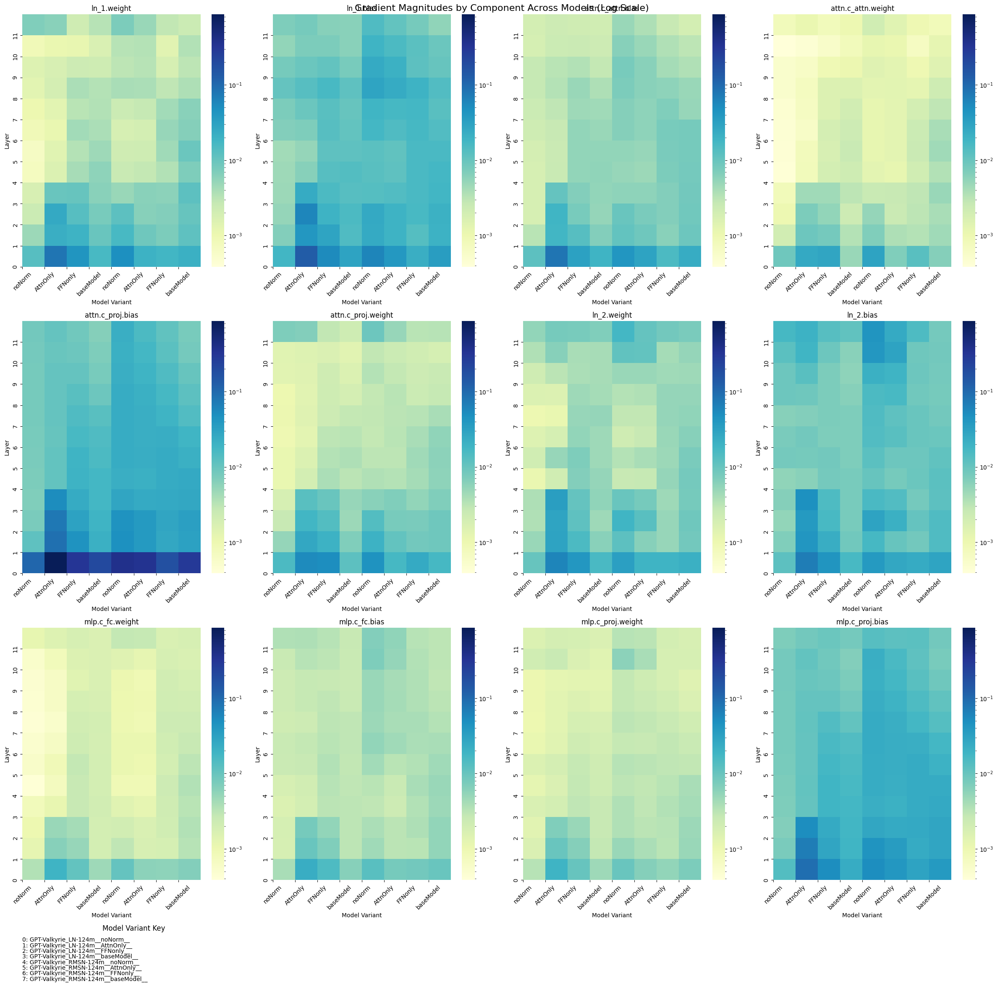

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import LogNorm

def calculate_gradient_magnitudes(model_name, prompt):
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")
    tokenizer.pad_token = tokenizer.eos_token

    model.train()
    inputs = tokenizer(prompt, return_tensors="pt")
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss
    loss.backward()

    gradients = {}
    for name, parameter in model.named_parameters():
        if parameter.grad is not None:
            gradients[name] = parameter.grad.abs().mean().item()

    return gradients, model

def calculate_layer_gradients(model, gradients):
    layer_gradients = []
    for i, layer in enumerate(model.transformer.h):
        # Check if the layer uses RMSNorm
        uses_rmsnorm = hasattr(layer, 'rmsnorm')  # Adjust based on actual attribute used for RMSNorm

        layer_gradient = {
            'ln_1.weight': gradients.get(f'transformer.h.{i}.ln_1.weight', 0),
            'ln_1.bias': gradients.get(f'transformer.h.{i}.ln_1.bias', 0) if not uses_rmsnorm else 0,
            'attn.c_attn.bias': gradients.get(f'transformer.h.{i}.attn.c_attn.bias', 0),
            'attn.c_attn.weight': gradients.get(f'transformer.h.{i}.attn.c_attn.weight', 0),
            'attn.c_proj.bias': gradients.get(f'transformer.h.{i}.attn.c_proj.bias', 0),
            'attn.c_proj.weight': gradients.get(f'transformer.h.{i}.attn.c_proj.weight', 0),
            'ln_2.weight': gradients.get(f'transformer.h.{i}.ln_2.weight', 0),
            'ln_2.bias': gradients.get(f'transformer.h.{i}.ln_2.bias', 0) if not uses_rmsnorm else 0,
            'mlp.c_fc.weight': gradients.get(f'transformer.h.{i}.mlp.c_fc.weight', 0),
            'mlp.c_fc.bias': gradients.get(f'transformer.h.{i}.mlp.c_fc.bias', 0),
            'mlp.c_proj.weight': gradients.get(f'transformer.h.{i}.mlp.c_proj.weight', 0),
            'mlp.c_proj.bias': gradients.get(f'transformer.h.{i}.mlp.c_proj.bias', 0),
        }
        layer_gradients.append(layer_gradient)
    return layer_gradients

def visualize_components_across_models(all_layer_gradients, model_variants, vmin, vmax, use_log_scale=True):
    num_components = len(all_layer_gradients[0][0])
    num_layers = len(all_layer_gradients[0])
    num_models = len(model_variants)

    fig, axs = plt.subplots(4, 4, figsize=(24, 24), gridspec_kw={'height_ratios': [1, 1, 1, 0.2]})
    scale_type = "Log" if use_log_scale else "Normal"
    fig.suptitle(f"Gradient Magnitudes by Component Across Models ({scale_type} Scale)", fontsize=16)

    for idx, component in enumerate(all_layer_gradients[0][0].keys()):
        ax = axs[idx // 4, idx % 4]
        # Transpose the data array to swap the axes
        component_data = np.array([[layer_gradients[layer][component] for layer_gradients in all_layer_gradients] for layer in range(num_layers)])

        if use_log_scale:
            sns.heatmap(component_data, annot=False, fmt=".2e", cmap="YlGnBu",
                        ax=ax, cbar=True, norm=LogNorm(vmin=vmin, vmax=vmax))
        else:
            sns.heatmap(component_data, annot=False, fmt=".2e", cmap="YlGnBu",
                        ax=ax, cbar=True, vmin=vmin, vmax=vmax)

        ax.set_title(component)
        ax.set_xlabel("Model Variant")
        ax.set_ylabel("Layer")
        ax.set_xticks(range(num_models))
        ax.set_xticklabels([model.split('__')[1] for model in model_variants], rotation=45)
        ax.set_yticks(range(num_layers))
        ax.set_yticklabels(range(num_layers))
        ax.invert_yaxis()  # This will make the layer 0 start from the bottom

    # Add a key for model variants
    key_ax = axs[3, :]
    for ax in key_ax:
        ax.axis('off')
    key_ax[0].axis('on')
    key_ax[0].set_xlim(0, 1)
    key_ax[0].set_ylim(0, 1)
    key_ax[0].axis('off')

    for i, model in enumerate(model_variants):
        model_name = model.split('/')[-1]  # Get the last part of the model name, assuming it's descriptive
        key_ax[0].text(0, 1 - (i + 1) / (num_models + 1), f"{i}: {model_name}", va='center', ha='left', fontsize=10)

    key_ax[0].set_title("Model Variant Key", fontsize=12)

    plt.tight_layout()
    plt.show()

# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
]

prompt = "Once upon a time in a land far, far away"

# Calculate gradients for all models
all_layer_gradients = []
for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    gradients, model = calculate_gradient_magnitudes(model_name, prompt)
    layer_gradients = calculate_layer_gradients(model, gradients)
    all_layer_gradients.append(layer_gradients)

# Calculate global min and max across all models
all_gradients = [grad for model_gradients in all_layer_gradients for layer in model_gradients for grad in layer.values()]
vmin, vmax = max(min(all_gradients), 1e-10), max(all_gradients)  # Avoid log(0)

# Visualize components across all models
visualize_components_across_models(all_layer_gradients, model_variants, vmin, vmax)

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__
Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__FFNonly__
Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__baseModel__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__noNorm__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__baseModel__


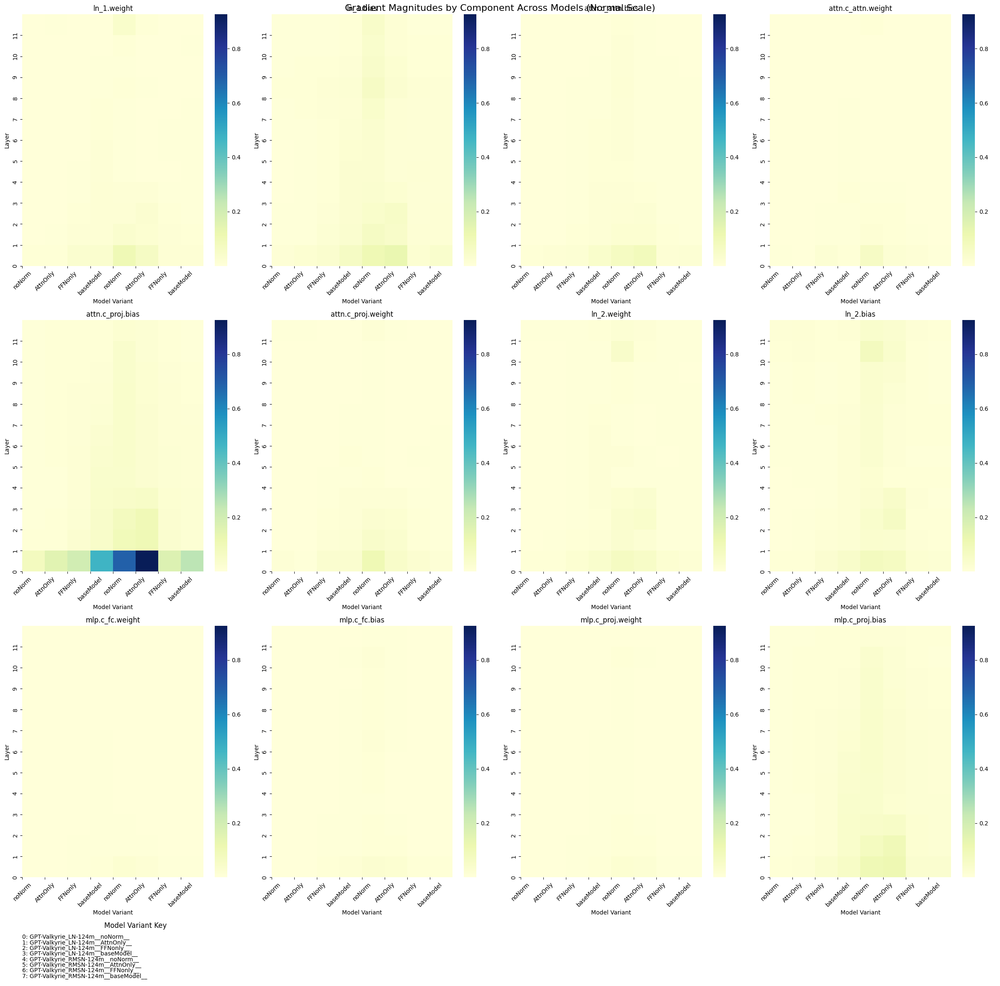

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def calculate_gradient_magnitudes(model_name, prompt):
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")
    tokenizer.pad_token = tokenizer.eos_token

    model.train()
    inputs = tokenizer(prompt, return_tensors="pt")
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss
    loss.backward()

    gradients = {}
    for name, parameter in model.named_parameters():
        if parameter.grad is not None:
            gradients[name] = parameter.grad.abs().mean().item()

    return gradients, model

def calculate_layer_gradients(model, gradients):
    layer_gradients = []
    for i, layer in enumerate(model.transformer.h):
        # Check if the layer uses RMSNorm
        uses_rmsnorm = hasattr(layer, 'rmsnorm')  # Adjust based on actual attribute used for RMSNorm

        layer_gradient = {
            'ln_1.weight': gradients.get(f'transformer.h.{i}.ln_1.weight', 0),
            'ln_1.bias': gradients.get(f'transformer.h.{i}.ln_1.bias', 0) if not uses_rmsnorm else 0,
            'attn.c_attn.bias': gradients.get(f'transformer.h.{i}.attn.c_attn.bias', 0),
            'attn.c_attn.weight': gradients.get(f'transformer.h.{i}.attn.c_attn.weight', 0),
            'attn.c_proj.bias': gradients.get(f'transformer.h.{i}.attn.c_proj.bias', 0),
            'attn.c_proj.weight': gradients.get(f'transformer.h.{i}.attn.c_proj.weight', 0),
            'ln_2.weight': gradients.get(f'transformer.h.{i}.ln_2.weight', 0),
            'ln_2.bias': gradients.get(f'transformer.h.{i}.ln_2.bias', 0) if not uses_rmsnorm else 0,
            'mlp.c_fc.weight': gradients.get(f'transformer.h.{i}.mlp.c_fc.weight', 0),
            'mlp.c_fc.bias': gradients.get(f'transformer.h.{i}.mlp.c_fc.bias', 0),
            'mlp.c_proj.weight': gradients.get(f'transformer.h.{i}.mlp.c_proj.weight', 0),
            'mlp.c_proj.bias': gradients.get(f'transformer.h.{i}.mlp.c_proj.bias', 0),
        }
        layer_gradients.append(layer_gradient)
    return layer_gradients

def visualize_components_across_models(all_layer_gradients, model_variants, vmin, vmax, use_log_scale=False):
    num_components = len(all_layer_gradients[0][0])
    num_layers = len(all_layer_gradients[0])
    num_models = len(model_variants)

    fig, axs = plt.subplots(4, 4, figsize=(24, 24), gridspec_kw={'height_ratios': [1, 1, 1, 0.2]})
    scale_type = "Log" if use_log_scale else "Normal"
    fig.suptitle(f"Gradient Magnitudes by Component Across Models ({scale_type} Scale)", fontsize=16)

    for idx, component in enumerate(all_layer_gradients[0][0].keys()):
        ax = axs[idx // 4, idx % 4]
        # Transpose the data array to swap the axes
        component_data = np.array([[layer_gradients[layer][component] for layer_gradients in all_layer_gradients] for layer in range(num_layers)])

        if use_log_scale:
            sns.heatmap(component_data, annot=False, fmt=".2e", cmap="YlGnBu",
                        ax=ax, cbar=True, norm=LogNorm(vmin=vmin, vmax=vmax))
        else:
            sns.heatmap(component_data, annot=False, fmt=".2e", cmap="YlGnBu",
                        ax=ax, cbar=True, vmin=vmin, vmax=vmax)

        ax.set_title(component)
        ax.set_xlabel("Model Variant")
        ax.set_ylabel("Layer")
        ax.set_xticks(range(num_models))
        ax.set_xticklabels([model.split('__')[1] for model in model_variants], rotation=45)
        ax.set_yticks(range(num_layers))
        ax.set_yticklabels(range(num_layers))
        ax.invert_yaxis()  # This will make the layer 0 start from the bottom

    # Add a key for model variants
    key_ax = axs[3, :]
    for ax in key_ax:
        ax.axis('off')
    key_ax[0].axis('on')
    key_ax[0].set_xlim(0, 1)
    key_ax[0].set_ylim(0, 1)
    key_ax[0].axis('off')

    for i, model in enumerate(model_variants):
        model_name = model.split('/')[-1]  # Get the last part of the model name, assuming it's descriptive
        key_ax[0].text(0, 1 - (i + 1) / (num_models + 1), f"{i}: {model_name}", va='center', ha='left', fontsize=10)

    key_ax[0].set_title("Model Variant Key", fontsize=12)

    plt.tight_layout()
    plt.show()
# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
]

prompt = "Once upon a time in a land far, far away"

# Calculate gradients for all models
all_layer_gradients = []
for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    gradients, model = calculate_gradient_magnitudes(model_name, prompt)
    layer_gradients = calculate_layer_gradients(model, gradients)
    all_layer_gradients.append(layer_gradients)

# Calculate global min and max across all models
all_gradients = [grad for model_gradients in all_layer_gradients for layer in model_gradients for grad in layer.values()]
vmin, vmax = min(all_gradients), max(all_gradients)

# Visualize components across all models
visualize_components_across_models(all_layer_gradients, model_variants, vmin, vmax)

# SQuAD

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__SQuAD


config.json:   0%|          | 0.00/850 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/665 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__SQuAD


config.json:   0%|          | 0.00/854 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__FFNonly__SQuAD


config.json:   0%|          | 0.00/852 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__baseModel__SQuAD


config.json:   0%|          | 0.00/825 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__noNorm__SQuAD


config.json:   0%|          | 0.00/852 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__SQuAD


config.json:   0%|          | 0.00/856 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__SQuAD


config.json:   0%|          | 0.00/854 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__baseModel__SQuAD


config.json:   0%|          | 0.00/827 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/498M [00:00<?, ?B/s]

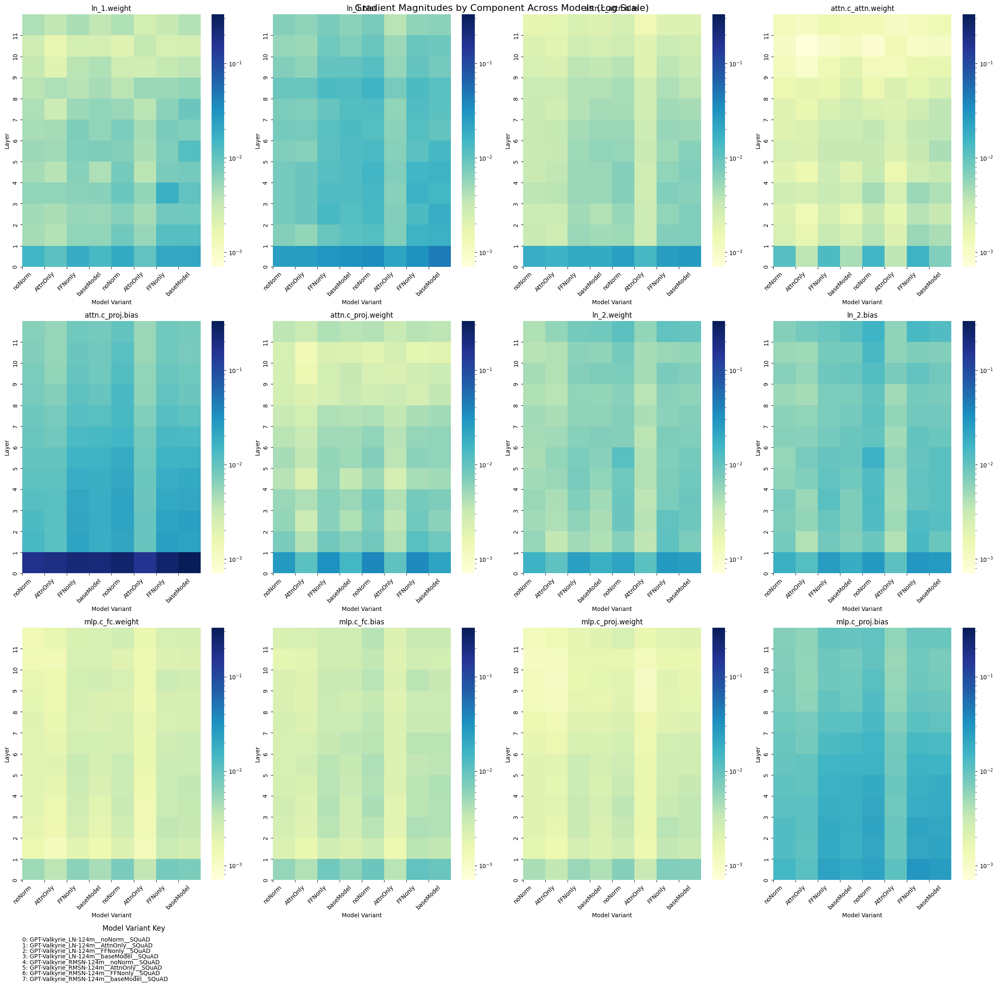

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import LogNorm

def calculate_gradient_magnitudes(model_name, prompt):
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")
    tokenizer.pad_token = tokenizer.eos_token

    model.train()
    inputs = tokenizer(prompt, return_tensors="pt")
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss
    loss.backward()

    gradients = {}
    for name, parameter in model.named_parameters():
        if parameter.grad is not None:
            gradients[name] = parameter.grad.abs().mean().item()

    return gradients, model

def calculate_layer_gradients(model, gradients):
    layer_gradients = []
    for i, layer in enumerate(model.transformer.h):
        # Check if the layer uses RMSNorm
        uses_rmsnorm = hasattr(layer, 'rmsnorm')  # Adjust based on actual attribute used for RMSNorm

        layer_gradient = {
            'ln_1.weight': gradients.get(f'transformer.h.{i}.ln_1.weight', 0),
            'ln_1.bias': gradients.get(f'transformer.h.{i}.ln_1.bias', 0) if not uses_rmsnorm else 0,
            'attn.c_attn.bias': gradients.get(f'transformer.h.{i}.attn.c_attn.bias', 0),
            'attn.c_attn.weight': gradients.get(f'transformer.h.{i}.attn.c_attn.weight', 0),
            'attn.c_proj.bias': gradients.get(f'transformer.h.{i}.attn.c_proj.bias', 0),
            'attn.c_proj.weight': gradients.get(f'transformer.h.{i}.attn.c_proj.weight', 0),
            'ln_2.weight': gradients.get(f'transformer.h.{i}.ln_2.weight', 0),
            'ln_2.bias': gradients.get(f'transformer.h.{i}.ln_2.bias', 0) if not uses_rmsnorm else 0,
            'mlp.c_fc.weight': gradients.get(f'transformer.h.{i}.mlp.c_fc.weight', 0),
            'mlp.c_fc.bias': gradients.get(f'transformer.h.{i}.mlp.c_fc.bias', 0),
            'mlp.c_proj.weight': gradients.get(f'transformer.h.{i}.mlp.c_proj.weight', 0),
            'mlp.c_proj.bias': gradients.get(f'transformer.h.{i}.mlp.c_proj.bias', 0),
        }
        layer_gradients.append(layer_gradient)
    return layer_gradients

def visualize_components_across_models(all_layer_gradients, model_variants, vmin, vmax, use_log_scale=True):
    num_components = len(all_layer_gradients[0][0])
    num_layers = len(all_layer_gradients[0])
    num_models = len(model_variants)

    fig, axs = plt.subplots(4, 4, figsize=(24, 24), gridspec_kw={'height_ratios': [1, 1, 1, 0.2]})
    scale_type = "Log" if use_log_scale else "Normal"
    fig.suptitle(f"Gradient Magnitudes by Component Across Models ({scale_type} Scale)", fontsize=16)

    for idx, component in enumerate(all_layer_gradients[0][0].keys()):
        ax = axs[idx // 4, idx % 4]
        # Transpose the data array to swap the axes
        component_data = np.array([[layer_gradients[layer][component] for layer_gradients in all_layer_gradients] for layer in range(num_layers)])

        if use_log_scale:
            sns.heatmap(component_data, annot=False, fmt=".2e", cmap="YlGnBu",
                        ax=ax, cbar=True, norm=LogNorm(vmin=vmin, vmax=vmax))
        else:
            sns.heatmap(component_data, annot=False, fmt=".2e", cmap="YlGnBu",
                        ax=ax, cbar=True, vmin=vmin, vmax=vmax)

        ax.set_title(component)
        ax.set_xlabel("Model Variant")
        ax.set_ylabel("Layer")
        ax.set_xticks(range(num_models))
        ax.set_xticklabels([model.split('__')[1] for model in model_variants], rotation=45)
        ax.set_yticks(range(num_layers))
        ax.set_yticklabels(range(num_layers))
        ax.invert_yaxis()  # This will make the layer 0 start from the bottom

    # Add a key for model variants
    key_ax = axs[3, :]
    for ax in key_ax:
        ax.axis('off')
    key_ax[0].axis('on')
    key_ax[0].set_xlim(0, 1)
    key_ax[0].set_ylim(0, 1)
    key_ax[0].axis('off')

    for i, model in enumerate(model_variants):
        model_name = model.split('/')[-1]  # Get the last part of the model name, assuming it's descriptive
        key_ax[0].text(0, 1 - (i + 1) / (num_models + 1), f"{i}: {model_name}", va='center', ha='left', fontsize=10)

    key_ax[0].set_title("Model Variant Key", fontsize=12)

    plt.tight_layout()
    plt.show()

# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__SQuAD",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__SQuAD",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__SQuAD",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__SQuAD",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__SQuAD",
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__SQuAD",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__SQuAD",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__SQuAD",
]

prompt = "Once upon a time in a land far, far away"

# Calculate gradients for all models
all_layer_gradients = []
for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    gradients, model = calculate_gradient_magnitudes(model_name, prompt)
    layer_gradients = calculate_layer_gradients(model, gradients)
    all_layer_gradients.append(layer_gradients)

# Calculate global min and max across all models
all_gradients = [grad for model_gradients in all_layer_gradients for layer in model_gradients for grad in layer.values()]
vmin, vmax = max(min(all_gradients), 1e-10), max(all_gradients)  # Avoid log(0)

# Visualize components across all models
visualize_components_across_models(all_layer_gradients, model_variants, vmin, vmax)

# All layers and biases combined into 1,

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__
Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__FFNonly__
Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__baseModel__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__noNorm__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__baseModel__


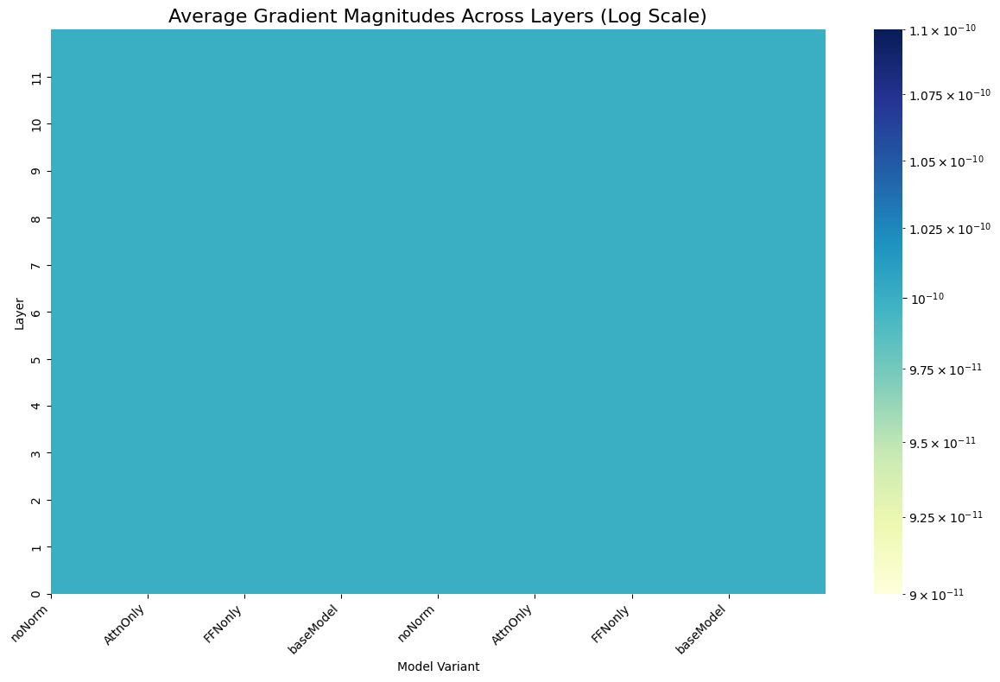

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import LogNorm

def calculate_gradient_magnitudes(model_name, prompt):
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")
    tokenizer.pad_token = tokenizer.eos_token

    model.train()
    inputs = tokenizer(prompt, return_tensors="pt")
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss
    loss.backward()

    gradients = {}
    for name, parameter in model.named_parameters():
        if parameter.grad is not None:
            gradients[name] = parameter.grad.abs().mean().item()

    return gradients, model

def calculate_layer_average_gradients(model, gradients):
    layer_avg_gradients = []
    for i, layer in enumerate(model.transformer.h):
        layer_gradients = [
            gradients.get(f'transformer.h.{i}.{param}', 0)
            for param in gradients.keys()
            if f'transformer.h.{i}.' in param
        ]
        layer_avg_gradients.append(np.mean(layer_gradients))
    return layer_avg_gradients

def visualize_average_gradients(all_layer_avg_gradients, model_variants, use_log_scale=True):
    num_layers = len(all_layer_avg_gradients[0])
    num_models = len(model_variants)

    plt.figure(figsize=(12, 8))
    scale_type = "Log" if use_log_scale else "Normal"
    plt.title(f"Average Gradient Magnitudes Across Layers ({scale_type} Scale)", fontsize=16)

    data = np.array(all_layer_avg_gradients).T

    # Set a minimum value for the data to avoid log(0) issues
    min_value = 1e-10
    data = np.maximum(data, min_value)

    if use_log_scale:
        sns.heatmap(data, annot=False, fmt=".2e", cmap="YlGnBu",
                    cbar=True, norm=LogNorm(vmin=min_value, vmax=data.max()))
    else:
        sns.heatmap(data, annot=False, fmt=".2e", cmap="YlGnBu",
                    cbar=True, vmin=min_value, vmax=data.max())

    plt.xlabel("Model Variant")
    plt.ylabel("Layer")
    plt.xticks(range(num_models), [model.split('__')[1] for model in model_variants], rotation=45, ha='right')
    plt.yticks(range(num_layers), range(num_layers))
    plt.gca().invert_yaxis()  # This will make the layer 0 start from the bottom

    plt.tight_layout()
    plt.show()

# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
]

prompt = "Once upon a time in a land far, far away"

# Calculate average gradients for all models
all_layer_avg_gradients = []
for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    try:
        gradients, model = calculate_gradient_magnitudes(model_name, prompt)
        layer_avg_gradients = calculate_layer_average_gradients(model, gradients)
        all_layer_avg_gradients.append(layer_avg_gradients)
    except Exception as e:
        print(f"Error processing {model_name}: {e}")
        all_layer_avg_gradients.append([0] * len(model.transformer.h))  # Append zeros if there's an error

# Visualize average gradients across all models
visualize_average_gradients(all_layer_avg_gradients, model_variants)

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import LogNorm

def calculate_gradient_magnitudes(model_name, prompt):
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")
    tokenizer.pad_token = tokenizer.eos_token

    model.train()
    inputs = tokenizer(prompt, return_tensors="pt")
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss
    loss.backward()

    gradients = {}
    for name, parameter in model.named_parameters():
        if parameter.grad is not None:
            grad_value = parameter.grad.abs().mean().item()
            if grad_value > 0:  # Only store non-zero gradients
                gradients[name] = grad_value

    return gradients, model

def calculate_layer_average_gradients(model, gradients):
    layer_avg_gradients = []
    for i, layer in enumerate(model.transformer.h):
        layer_gradients = [
            gradients.get(f'transformer.h.{i}.{param}', 0)
            for param in gradients.keys()
            if f'transformer.h.{i}.' in param
        ]
        layer_avg_gradients.append(np.mean(layer_gradients))
    return layer_avg_gradients

def visualize_average_gradients(all_layer_avg_gradients, model_variants):
    num_layers = len(all_layer_avg_gradients[0])
    num_models = len(model_variants)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 8))

    data = np.array(all_layer_avg_gradients).T

    # Handle the case where all values might be zero or negative
    min_positive = np.min(data[data > 0]) if np.any(data > 0) else 1e-10
    data_log = np.maximum(data, min_positive)

    # Log scale plot
    sns.heatmap(data_log, annot=False, fmt=".2e", cmap="YlGnBu",
                cbar=True, norm=LogNorm(vmin=min_positive, vmax=data_log.max()), ax=ax1)
    ax1.set_title("Average Gradient Magnitudes (Log Scale)", fontsize=16)
    ax1.set_xlabel("Model Variant")
    ax1.set_ylabel("Layer")
    ax1.set_xticks(range(num_models))
    ax1.set_xticklabels([model.split('__')[1] for model in model_variants], rotation=45, ha='right')
    ax1.set_yticks(range(num_layers))
    ax1.set_yticklabels(range(num_layers))
    ax1.invert_yaxis()

    # Linear scale plot
    sns.heatmap(data, annot=False, fmt=".2e", cmap="YlGnBu",
                cbar=True, ax=ax2)
    ax2.set_title("Average Gradient Magnitudes (Linear Scale)", fontsize=16)
    ax2.set_xlabel("Model Variant")
    ax2.set_ylabel("Layer")
    ax2.set_xticks(range(num_models))
    ax2.set_xticklabels([model.split('__')[1] for model in model_variants], rotation=45, ha='right')
    ax2.set_yticks(range(num_layers))
    ax2.set_yticklabels(range(num_layers))
    ax2.invert_yaxis()

    plt.tight_layout()
    plt.show()

    # Print some statistics about the data
    print(f"Minimum non-zero gradient: {min_positive}")
    print(f"Maximum gradient: {np.max(data)}")
    print(f"Mean gradient: {np.mean(data)}")
    print(f"Median gradient: {np.median(data)}")

# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
]

prompt = "Once upon a time in a land far, far away"

# Calculate average gradients for all models
all_layer_avg_gradients = []
for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    try:
        gradients, model = calculate_gradient_magnitudes(model_name, prompt)
        if not gradients:
            print(f"Warning: No non-zero gradients found for {model_name}")
            all_layer_avg_gradients.append([0] * len(model.transformer.h))
        else:
            layer_avg_gradients = calculate_layer_average_gradients(model, gradients)
            all_layer_avg_gradients.append(layer_avg_gradients)
    except Exception as e:
        print(f"Error processing {model_name}: {e}")
        # Append zeros, but make sure we know the correct number of layers
        if 'model' in locals():
            all_layer_avg_gradients.append([0] * len(model.transformer.h))
        else:
            print(f"Unable to determine number of layers for {model_name}")
            # You might want to set a default number of layers here
            all_layer_avg_gradients.append([0] * 12)  # Assuming 12 layers as default

# Visualize average gradients across all models
visualize_average_gradients(all_layer_avg_gradients, model_variants)

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


KeyboardInterrupt: 

Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__noNorm__


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__
Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__FFNonly__
Calculating gradients for shng2025/GPT-Valkyrie_LN-124m__baseModel__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__noNorm__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__
Calculating gradients for shng2025/GPT-Valkyrie_RMSN-124m__baseModel__


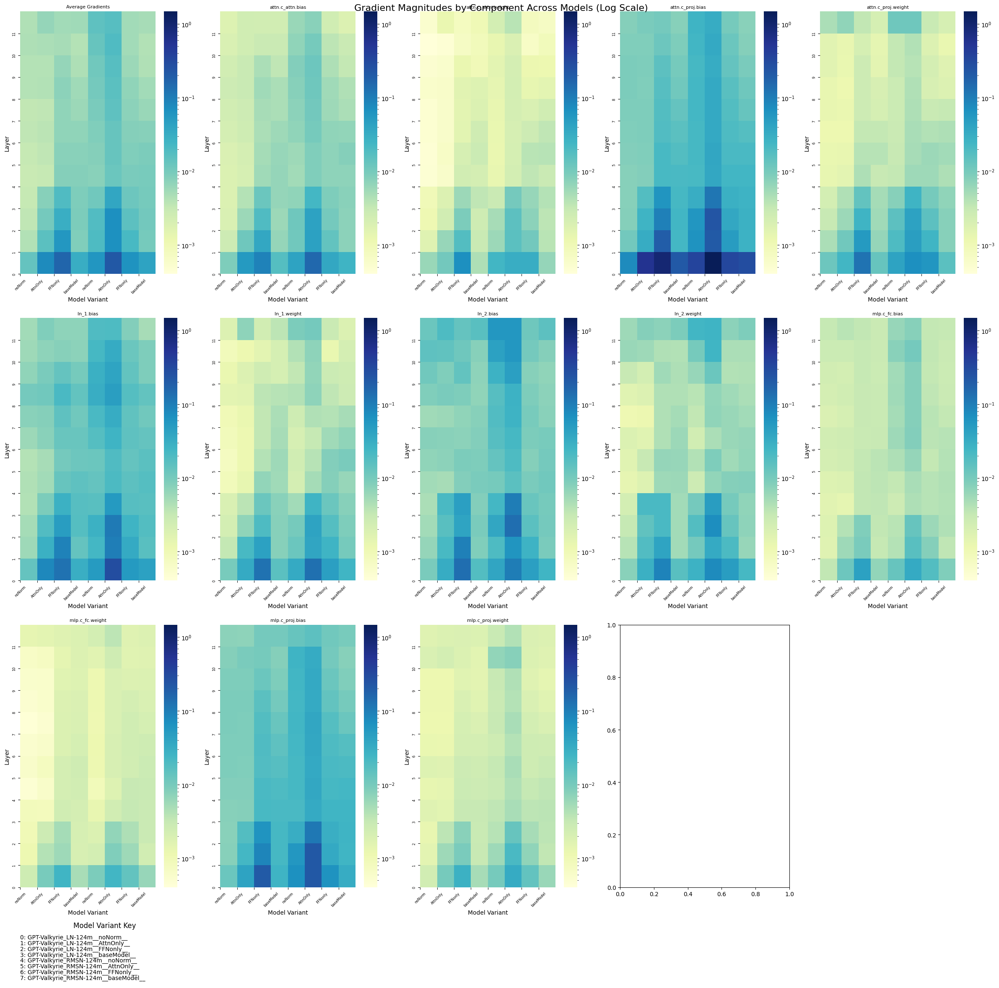

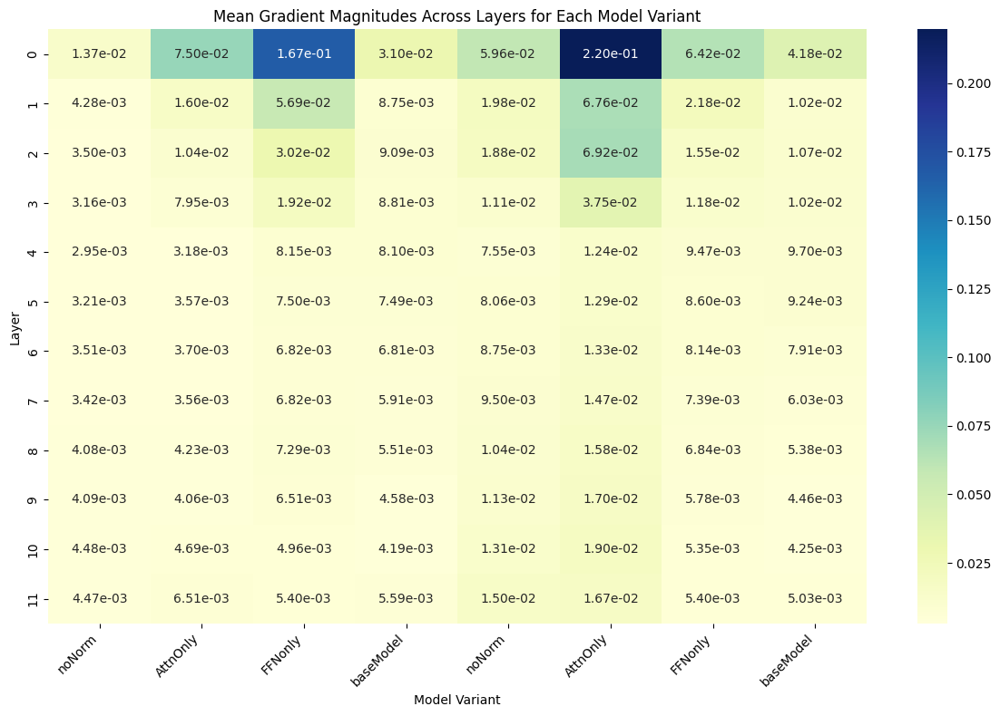


Gradient Statistics:
Minimum gradient: 0.00040435791015625
Maximum gradient: 1.4765625
Mean gradient: 0.017012190487649705
Median gradient: 0.0063323974609375

Unique components for shng2025/GPT-Valkyrie_LN-124m__noNorm__:
attn.c_attn.bias, attn.c_attn.weight, attn.c_proj.bias, attn.c_proj.weight, ln_1.bias, ln_1.weight, ln_2.bias, ln_2.weight, mlp.c_fc.bias, mlp.c_fc.weight, mlp.c_proj.bias, mlp.c_proj.weight

Unique components for shng2025/GPT-Valkyrie_LN-124m__AttnOnly__:
attn.c_attn.bias, attn.c_attn.weight, attn.c_proj.bias, attn.c_proj.weight, ln_1.bias, ln_1.weight, ln_2.bias, ln_2.weight, mlp.c_fc.bias, mlp.c_fc.weight, mlp.c_proj.bias, mlp.c_proj.weight

Unique components for shng2025/GPT-Valkyrie_LN-124m__FFNonly__:
attn.c_attn.bias, attn.c_attn.weight, attn.c_proj.bias, attn.c_proj.weight, ln_1.bias, ln_1.weight, ln_2.bias, ln_2.weight, mlp.c_fc.bias, mlp.c_fc.weight, mlp.c_proj.bias, mlp.c_proj.weight

Unique components for shng2025/GPT-Valkyrie_LN-124m__baseModel__:
attn.

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import LogNorm

def calculate_gradient_magnitudes(model_name, prompt):
    model = AutoModelForCausalLM.from_pretrained(model_name, torch_dtype=torch.bfloat16)
    tokenizer = AutoTokenizer.from_pretrained("gpt2")
    tokenizer.pad_token = tokenizer.eos_token

    model.train()
    inputs = tokenizer(prompt, return_tensors="pt")
    outputs = model(**inputs, labels=inputs["input_ids"])
    loss = outputs.loss
    loss.backward()

    gradients = {}
    for name, parameter in model.named_parameters():
        if parameter.grad is not None:
            gradients[name] = parameter.grad.abs().mean().item()

    return gradients, model

def calculate_layer_gradients(model, gradients):
    layer_gradients = []
    for i, layer in enumerate(model.transformer.h):
        layer_gradient = {}
        for name, value in gradients.items():
            if f'transformer.h.{i}.' in name:
                layer_gradient[name.split(f'transformer.h.{i}.')[-1]] = value
        layer_gradients.append(layer_gradient)
    return layer_gradients

def visualize_gradients(all_layer_gradients, model_variants, vmin, vmax, use_log_scale=True):
    # Get all unique component names
    all_components = set()
    for model_gradients in all_layer_gradients:
        for layer_gradient in model_gradients:
            all_components.update(layer_gradient.keys())
    all_components = sorted(list(all_components))

    num_components = len(all_components) + 1  # +1 for the average
    num_layers = len(all_layer_gradients[0])
    num_models = len(model_variants)

    # Calculate number of rows and columns for subplots
    num_cols = 5
    num_rows = (num_components + num_cols - 1) // num_cols + 1  # +1 for the key

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(24, 6 * num_rows),
                            gridspec_kw={'height_ratios': [1] * (num_rows - 1) + [0.2]})
    scale_type = "Log" if use_log_scale else "Normal"
    fig.suptitle(f"Gradient Magnitudes by Component Across Models ({scale_type} Scale)", fontsize=16)

    # Prepare data for average gradients
    avg_gradients = np.array([[np.mean(list(layer_gradients.values())) for layer_gradients in model_gradients]
                              for model_gradients in all_layer_gradients]).T

    # Plot average gradients first
    ax = axs[0, 0]
    if use_log_scale:
        sns.heatmap(avg_gradients, annot=False, fmt=".2e", cmap="YlGnBu",
                    ax=ax, cbar=True, norm=LogNorm(vmin=vmin, vmax=vmax))
    else:
        sns.heatmap(avg_gradients, annot=False, fmt=".2e", cmap="YlGnBu",
                    ax=ax, cbar=True, vmin=vmin, vmax=vmax)

    ax.set_title("Average Gradients", fontsize=8)
    ax.set_xlabel("Model Variant")
    ax.set_ylabel("Layer")
    ax.set_xticks(range(num_models))
    ax.set_xticklabels([model.split('__')[1] for model in model_variants], rotation=45, fontsize=6)
    ax.set_yticks(range(num_layers))
    ax.set_yticklabels(range(num_layers), fontsize=6)
    ax.invert_yaxis()

    # Plot individual component gradients
    for idx, component in enumerate(all_components, start=1):
        ax = axs[(idx) // num_cols, (idx) % num_cols]
        component_data = np.array([[layer_gradients.get(component, 0) for layer_gradients in model_gradients]
                                   for model_gradients in all_layer_gradients]).T

        if use_log_scale:
            sns.heatmap(component_data, annot=False, fmt=".2e", cmap="YlGnBu",
                        ax=ax, cbar=True, norm=LogNorm(vmin=vmin, vmax=vmax))
        else:
            sns.heatmap(component_data, annot=False, fmt=".2e", cmap="YlGnBu",
                        ax=ax, cbar=True, vmin=vmin, vmax=vmax)

        ax.set_title(component, fontsize=8)
        ax.set_xlabel("Model Variant")
        ax.set_ylabel("Layer")
        ax.set_xticks(range(num_models))
        ax.set_xticklabels([model.split('__')[1] for model in model_variants], rotation=45, fontsize=6)
        ax.set_yticks(range(num_layers))
        ax.set_yticklabels(range(num_layers), fontsize=6)
        ax.invert_yaxis()

    # Add a key for model variants
    key_ax = axs[-1, :]
    for ax in key_ax:
        ax.axis('off')
    key_ax[0].axis('on')
    key_ax[0].set_xlim(0, 1)
    key_ax[0].set_ylim(0, 1)
    key_ax[0].axis('off')

    for i, model in enumerate(model_variants):
        model_name = model.split('/')[-1]
        key_ax[0].text(0, 1 - (i + 1) / (num_models + 1), f"{i}: {model_name}", va='center', ha='left', fontsize=10)

    key_ax[0].set_title("Model Variant Key", fontsize=12)

    # Remove empty subplots
    for idx in range(num_components + 1, num_rows * num_cols - num_cols):
        fig.delaxes(axs.flatten()[idx])

    plt.tight_layout()
    plt.show()

def visualize_mean_gradients(all_layer_gradients, model_variants):
    num_layers = len(all_layer_gradients[0])
    num_models = len(model_variants)

    # Calculate mean gradients for each layer of each model
    mean_gradients = np.array([
        [np.mean(list(layer.values())) for layer in model_gradients]
        for model_gradients in all_layer_gradients
    ])

    # Create the heatmap
    plt.figure(figsize=(12, 8))
    sns.heatmap(mean_gradients.T, annot=True, fmt=".2e", cmap="YlGnBu",
                xticklabels=[model.split('__')[1] for model in model_variants],
                yticklabels=range(num_layers))

    plt.title("Mean Gradient Magnitudes Across Layers for Each Model Variant")
    plt.xlabel("Model Variant")
    plt.ylabel("Layer")
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

# List of model variants to compare
model_variants = [
    "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
    "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
    "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
    "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
]

prompt = "Once upon a time in a land far, far away"

# Calculate gradients for all models
all_layer_gradients = []
for model_name in model_variants:
    print(f"Calculating gradients for {model_name}")
    gradients, model = calculate_gradient_magnitudes(model_name, prompt)
    layer_gradients = calculate_layer_gradients(model, gradients)
    all_layer_gradients.append(layer_gradients)

# Calculate global min and max across all models
all_gradients = [grad for model_gradients in all_layer_gradients for layer in model_gradients for grad in layer.values()]
vmin, vmax = max(min(all_gradients), 1e-10), max(all_gradients)  # Avoid log(0)

# Visualize gradients across all models
visualize_gradients(all_layer_gradients, model_variants, vmin, vmax)
visualize_mean_gradients(all_layer_gradients, model_variants)

# Print some statistics
print("\nGradient Statistics:")
print(f"Minimum gradient: {vmin}")
print(f"Maximum gradient: {vmax}")
print(f"Mean gradient: {np.mean(all_gradients)}")
print(f"Median gradient: {np.median(all_gradients)}")

# Print unique components for each model
for i, model_name in enumerate(model_variants):
    unique_components = set(component for layer in all_layer_gradients[i] for component in layer.keys())
    print(f"\nUnique components for {model_name}:")
    print(", ".join(sorted(unique_components)))

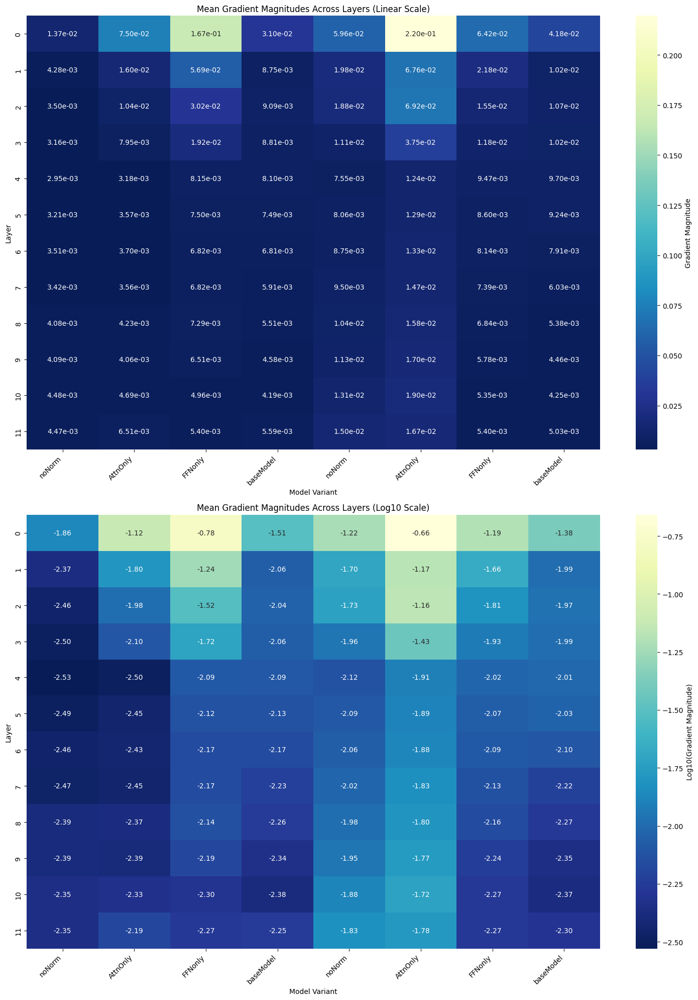


Gradient Statistics:
Minimum mean gradient: 0.002953688303629557
Maximum mean gradient: 0.21955362955729166
Overall mean gradient: 0.017012190487649705
Median mean gradient: 0.00812085469563802


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import LogNorm

def visualize_mean_gradients(all_layer_gradients, model_variants):
    num_layers = len(all_layer_gradients[0])
    num_models = len(model_variants)

    # Calculate mean gradients for each layer of each model
    mean_gradients = np.array([
        [np.mean(list(layer.values())) for layer in model_gradients]
        for model_gradients in all_layer_gradients
    ])

    # Calculate log of mean gradients, handling zeros and negative values
    epsilon = 1e-10  # Small value to avoid log(0)
    log_mean_gradients = np.log10(np.maximum(mean_gradients, epsilon))

    # Create a figure with two subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 20))

    # Custom colormap: dark blue to light yellow
    cmap = sns.color_palette("YlGnBu_r", as_cmap=True)

    # Linear scale heatmap
    sns.heatmap(mean_gradients.T, annot=True, fmt=".2e", cmap=cmap,
                xticklabels=[model.split('__')[1] for model in model_variants],
                yticklabels=range(num_layers), ax=ax1, cbar_kws={'label': 'Gradient Magnitude'})
    ax1.set_title("Mean Gradient Magnitudes Across Layers (Linear Scale)")
    ax1.set_xlabel("Model Variant")
    ax1.set_ylabel("Layer")
    ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, ha='right')

    # Log scale heatmap
    sns.heatmap(log_mean_gradients.T, annot=True, fmt=".2f", cmap=cmap,
                xticklabels=[model.split('__')[1] for model in model_variants],
                yticklabels=range(num_layers), ax=ax2, cbar_kws={'label': 'Log10(Gradient Magnitude)'})
    ax2.set_title("Mean Gradient Magnitudes Across Layers (Log10 Scale)")
    ax2.set_xlabel("Model Variant")
    ax2.set_ylabel("Layer")
    ax2.set_xticklabels(ax2.get_xticklabels(), rotation=45, ha='right')

    plt.tight_layout()
    plt.show()

    # Print some statistics
    print("\nGradient Statistics:")
    print(f"Minimum mean gradient: {np.min(mean_gradients)}")
    print(f"Maximum mean gradient: {np.max(mean_gradients)}")
    print(f"Overall mean gradient: {np.mean(mean_gradients)}")
    print(f"Median mean gradient: {np.median(mean_gradients)}")

# Assuming all_layer_gradients and model_variants are already defined
visualize_mean_gradients(all_layer_gradients, model_variants)

# Finale Gradient Analysis

### TextGen models

In [ ]:
prompts = [
    "The spaceship landed softly on the alien planet, and the hatch began to open.",
    "In a quiet village, a cat with mysterious powers arrived one rainy evening.",
    "The treasure map led them to a cave that had never been discovered before.",
    "As the clock struck midnight, the mirror began to shimmer.",
    "The forest was said to be cursed, but she ventured inside anyway.",
    "A mysterious letter arrived in the mail, addressed to someone who no longer lived here.",
    "At the bottom of the ocean, they found a door that led to another world.",
    "The robot slowly gained emotions, surprising its creators.",
    "Every time he fell asleep, he would wake up in a new timeline.",
    "They say that whoever solves the riddle of the ancient book gains unlimited knowledge.",
    "The day the stars disappeared, humanity knew something was coming.",
    "A portal opened in the backyard, leading to a dimension of pure imagination.",
    "The detective knew this was no ordinary case when the painting began to move.",
    "On her 18th birthday, she discovered she could control the wind.",
    "The world froze in time, except for one boy.",
    "The enchanted necklace began to glow whenever danger was near.",
    "He had only one chance to change the past, and the clock was ticking.",
    "The library was full of books no one had ever read before, and each held a hidden secret.",
    "A voice from the radio gave her instructions for an impossible mission.",
    "The moment she touched the ancient artifact, visions flooded her mind.",
    "In the attic, they found a diary that told of future events.",
    "A dragon had been asleep under the city for centuries, and now it was waking up.",
    "Each time he looked in the mirror, a different person stared back.",
    "A storm brought something unexpected to the small town.",
    "Her drawings started coming to life one by one.",
    "The message in the bottle warned of a great danger.",
    "The town vanished overnight, leaving only one survivor.",
    "He discovered that every wish he made came with a price.",
    "A snowstorm trapped them in the cabin, but they weren't alone.",
    "The clock in the town square began running backward.",
    "As the comet passed, everyone suddenly gained strange abilities.",
    "The bridge appeared only under a full moon.",
    "A stray cat followed him everywhere, but it wasn't an ordinary cat.",
    "The carnival arrived without warning, and so did the strange occurrences.",
    "In his dreams, a mysterious figure kept warning him about the future.",
    "Every door in the house led to a different world.",
    "The garden bloomed with flowers no one had ever seen before.",
    "A mysterious shadow followed her everywhere she went.",
    "The phone rang, and the voice on the other end knew too much.",
    "The clockmaker's new invention could turn back time.",
    "The lighthouse was abandoned, but its light still shone every night.",
    "Every star in the night sky represented a different soul.",
    "The forest whispered secrets to those who listened closely.",
    "The old camera developed pictures from events that hadn’t happened yet.",
    "A message appeared on her phone, and it was from the future.",
    "The ghost offered a deal too good to be true.",
    "A library card granted access to books that didn’t exist in the real world.",
    "As soon as they touched the stone, they were transported to another realm.",
    "Each song on the old record player told a different person’s life story.",
    "They found a map that changed every time they looked at it."
]


Using device: cuda
Processing shng2025/GPT-Valkyrie_LN-124m__noNorm__
  Processing prompt 1/1


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Processing shng2025/GPT-Valkyrie_LN-124m__AttnOnly__
  Processing prompt 1/1
Processing shng2025/GPT-Valkyrie_LN-124m__FFNonly__
  Processing prompt 1/1
Processing shng2025/GPT-Valkyrie_LN-124m__baseModel__
  Processing prompt 1/1
Processing shng2025/GPT-Valkyrie_RMSN-124m__noNorm__
  Processing prompt 1/1
Processing shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__
  Processing prompt 1/1
Processing shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__
  Processing prompt 1/1
Processing shng2025/GPT-Valkyrie_RMSN-124m__baseModel__
  Processing prompt 1/1


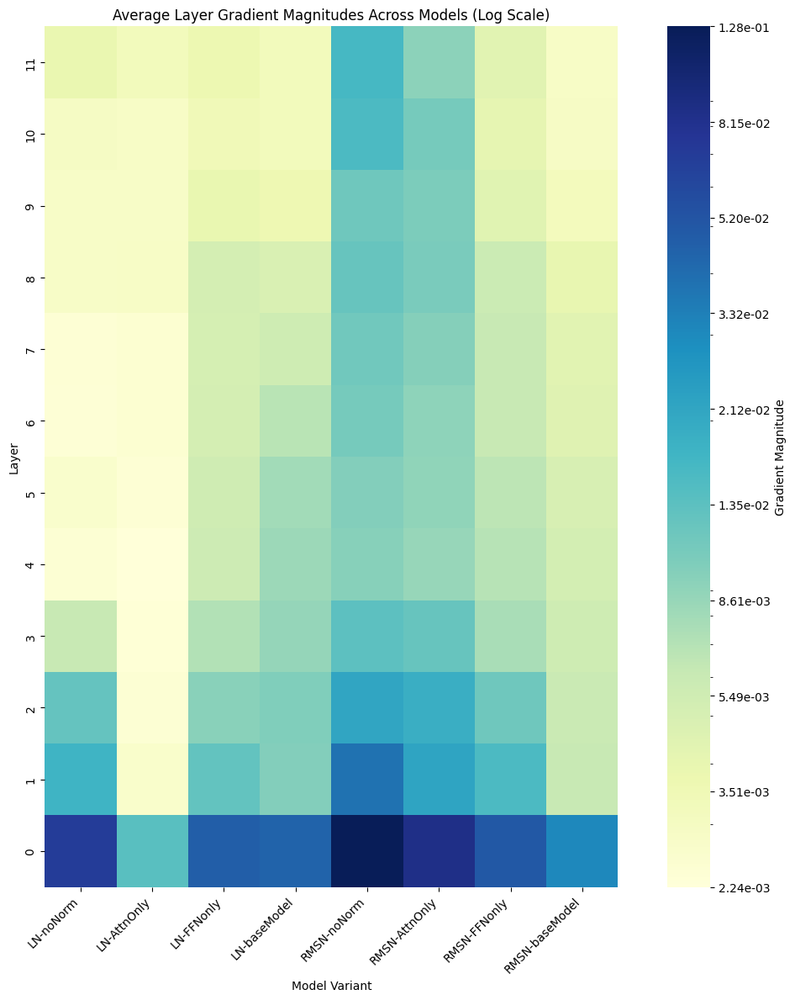

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import LogNorm

def get_device():
    if torch.cuda.is_available():
        return torch.device("cuda")
    else:
        print("CUDA not available, falling back to CPU")
        return torch.device("cpu")

def calculate_gradient_magnitudes(model_name, prompt, device):
    try:
        model = AutoModelForCausalLM.from_pretrained(
            model_name,
            torch_dtype=torch.bfloat16,
            device_map="auto"  # This will automatically handle multi-GPU setups if available
        ).to(device)

        tokenizer = AutoTokenizer.from_pretrained("gpt2")
        tokenizer.pad_token = tokenizer.eos_token

        model.train()
        inputs = tokenizer(prompt, return_tensors="pt").to(device)

        # Clear any existing gradients
        model.zero_grad()

        outputs = model(**inputs, labels=inputs["input_ids"])
        loss = outputs.loss
        loss.backward()

        gradients = {}
        for name, parameter in model.named_parameters():
            if parameter.grad is not None:
                # Move gradient to CPU for numpy operations
                gradients[name] = parameter.grad.abs().mean().cpu().item()

        # Clear memory
        del outputs
        del loss
        torch.cuda.empty_cache()

        return gradients, model

    except Exception as e:
        print(f"Error processing {model_name}: {str(e)}")
        raise

def calculate_layer_averages(model, gradients):
    layer_averages = []

    for i, layer in enumerate(model.transformer.h):
        layer_grads = []
        prefix = f'transformer.h.{i}.'

        for name, value in gradients.items():
            if name.startswith(prefix):
                layer_grads.append(value)

        if layer_grads:
            layer_averages.append(np.mean(layer_grads))

    return layer_averages

def get_model_label(model_name):
    """Extract norm type and variant from model name."""
    # Split by double underscore to separate components
    parts = model_name.split('__')

    # Extract norm type (LN or RMSN)
    if "LN-124m" in parts[0]:
        norm_type = "LN"
    elif "RMSN-124m" in parts[0]:
        norm_type = "RMSN"
    else:
        norm_type = "unknown"

    # Extract variant from middle component
    if len(parts) > 1:
        variant = parts[1]  # This will be noNorm, AttnOnly, FFNonly, or baseModel
    else:
        variant = "unknown"

    return f"{norm_type}-{variant}"

def visualize_layer_gradients(all_layer_averages, model_variants, prompts, vmin=None, vmax=None, use_log_scale=True):
    """Visualize gradient magnitudes across layers and models."""
    # Calculate average across all prompts for each model and layer
    averaged_gradients = np.mean(all_layer_averages, axis=1)

    num_layers = averaged_gradients.shape[1]
    num_models = len(model_variants)

    # Create figure with specific aspect ratio for square cells
    plt.figure(figsize=(12, 12))

    # Set scale and limits
    if vmin is None:
        vmin = max(np.min(averaged_gradients), 1e-10)
    if vmax is None:
        vmax = np.max(averaged_gradients)

    # Create heatmap without annotations
    heatmap_kwargs = {
        'data': averaged_gradients.T,  # No need to flip if using proper y-axis inversion
        'cmap': "YlGnBu",
        'annot': False,
        'square': True,
    }

    if use_log_scale:
        heatmap_kwargs.update({
            'norm': LogNorm(vmin=vmin, vmax=vmax),
            'cbar_kws': {
                'label': 'Gradient Magnitude',
                'format': '%.2e',
                'ticks': np.logspace(np.log10(vmin), np.log10(vmax), 10)
            }
        })
    else:
        heatmap_kwargs.update({
            'vmin': vmin,
            'vmax': vmax,
            'cbar_kws': {
                'label': 'Gradient Magnitude',
                'format': '%.2f'
            }
        })

    ax = sns.heatmap(**heatmap_kwargs)

    # Format x-axis labels using the improved label extraction
    x_labels = [get_model_label(model) for model in model_variants]
    plt.xticks(np.arange(len(model_variants)) + 0.5,
               x_labels,
               rotation=45,
               ha='right')

    # Format y-axis with proper layer numbering (0 to num_layers-1)
    plt.yticks(np.arange(num_layers) + 0.5,
               range(num_layers))

    # Invert y-axis to have 0 at bottom
    ax.invert_yaxis()

    plt.xlabel("Model Variant")
    plt.ylabel("Layer")
    scale_type = "Log" if use_log_scale else "Linear"
    plt.title(f"Average Layer Gradient Magnitudes Across Models ({scale_type} Scale)")

    plt.tight_layout()
    plt.show()

def run_gradient_analysis(model_variants, prompts):
    device = get_device()
    print(f"Using device: {device}")

    all_layer_averages = []

    try:
        for model_name in model_variants:
            print(f"Processing {model_name}")
            model_averages = []

            for i, prompt in enumerate(prompts):
                print(f"  Processing prompt {i+1}/{len(prompts)}")
                gradients, model = calculate_gradient_magnitudes(model_name, prompt, device)
                layer_averages = calculate_layer_averages(model, gradients)
                model_averages.append(layer_averages)

                # Clear CUDA cache after each prompt
                del model
                torch.cuda.empty_cache()

            all_layer_averages.append(model_averages)

        all_layer_averages = np.array(all_layer_averages)
        visualize_layer_gradients(all_layer_averages, model_variants, prompts)

    except Exception as e:
        print(f"Error during analysis: {str(e)}")
        raise
    finally:
        # Final cleanup
        torch.cuda.empty_cache()

# Example usage:
if __name__ == "__main__":
    model_variants = [
        "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
        "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
        "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
        "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
        "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
        "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
        "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
        "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
    ]

    run_gradient_analysis(model_variants, prompts)

Using device: cuda
Processing shng2025/GPT-Valkyrie_LN-124m__noNorm__
  Processing prompt 1/50


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


  Processing prompt 2/50
  Processing prompt 3/50
  Processing prompt 4/50
  Processing prompt 5/50
  Processing prompt 6/50
  Processing prompt 7/50
  Processing prompt 8/50
  Processing prompt 9/50
  Processing prompt 10/50
  Processing prompt 11/50
  Processing prompt 12/50
  Processing prompt 13/50
  Processing prompt 14/50
  Processing prompt 15/50
  Processing prompt 16/50
  Processing prompt 17/50
  Processing prompt 18/50
  Processing prompt 19/50
  Processing prompt 20/50
  Processing prompt 21/50
  Processing prompt 22/50
  Processing prompt 23/50
  Processing prompt 24/50
  Processing prompt 25/50
  Processing prompt 26/50
  Processing prompt 27/50
  Processing prompt 28/50
  Processing prompt 29/50
  Processing prompt 30/50
  Processing prompt 31/50
  Processing prompt 32/50
  Processing prompt 33/50
  Processing prompt 34/50
  Processing prompt 35/50
  Processing prompt 36/50
  Processing prompt 37/50
  Processing prompt 38/50
  Processing prompt 39/50
  Processing prompt 

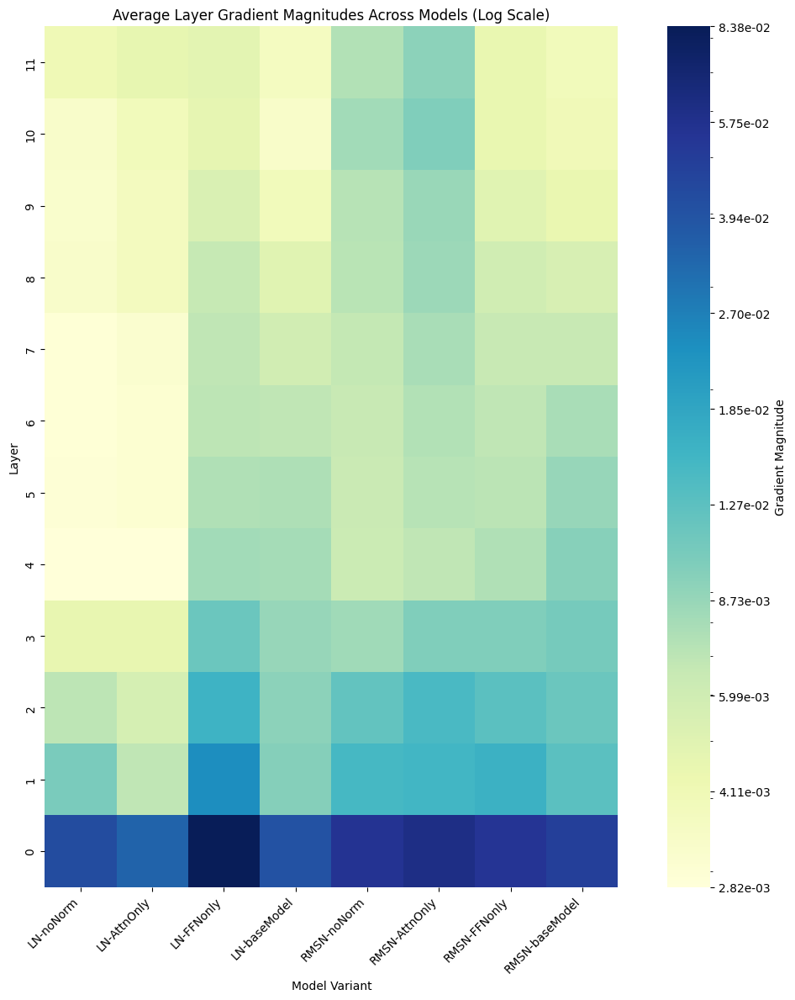

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import LogNorm
import pandas as pd
import os

def save_gradients_to_csv(all_layer_averages, model_variants, task="textgen", output_dir="gradient_results/averages"):
    """Save averaged gradient values to CSV file."""
    # Create output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)

    # Calculate average across all prompts
    avg_gradients = np.mean(all_layer_averages, axis=1)  # Shape: (num_models, num_layers)

    # Convert to DataFrame
    df = pd.DataFrame(avg_gradients, index=model_variants)
    df.columns = [f"layer_{i}" for i in range(df.shape[1])]

    # Save to CSV
    filename = os.path.join(output_dir, f"{task}_gradients.csv")
    df.to_csv(filename)
    print(f"Saved averaged gradient values to {filename}")
    return filename

def load_gradients_from_csv(task="textgen", input_dir="gradient_results/averages"):
    """Load gradient values from CSV file."""
    filename = os.path.join(input_dir, f"{task}_gradients.csv")

    if not os.path.exists(filename):
        raise FileNotFoundError(f"No gradient file found: {filename}")

    df = pd.read_csv(filename, index_col=0)
    return df.values, df.index.tolist()

def visualize_layer_gradients(all_layer_averages, model_variants, prompts, vmin=None, vmax=None, use_log_scale=True):
    """Visualize gradient magnitudes across layers and models."""
    # Calculate average across all prompts for each model and layer
    averaged_gradients = np.mean(all_layer_averages, axis=1)

    num_layers = averaged_gradients.shape[1]
    num_models = len(model_variants)

    # Create figure with specific aspect ratio for square cells
    plt.figure(figsize=(12, 12))

    # Set scale and limits
    if vmin is None:
        vmin = max(np.min(averaged_gradients), 1e-10)
    if vmax is None:
        vmax = np.max(averaged_gradients)

    # Create heatmap without annotations
    heatmap_kwargs = {
        'data': averaged_gradients.T,  # No need to flip if using proper y-axis inversion
        'cmap': "YlGnBu",
        'annot': False,
        'square': True,
    }

    if use_log_scale:
        heatmap_kwargs.update({
            'norm': LogNorm(vmin=vmin, vmax=vmax),
            'cbar_kws': {
                'label': 'Gradient Magnitude',
                'format': '%.2e',
                'ticks': np.logspace(np.log10(vmin), np.log10(vmax), 10)
            }
        })
    else:
        heatmap_kwargs.update({
            'vmin': vmin,
            'vmax': vmax,
            'cbar_kws': {
                'label': 'Gradient Magnitude',
                'format': '%.2f'
            }
        })

    ax = sns.heatmap(**heatmap_kwargs)

    # Format x-axis labels using the improved label extraction
    x_labels = [get_model_label(model) for model in model_variants]
    plt.xticks(np.arange(len(model_variants)) + 0.5,
               x_labels,
               rotation=45,
               ha='right')

    # Format y-axis with proper layer numbering (0 to num_layers-1)
    plt.yticks(np.arange(num_layers) + 0.5,
               range(num_layers))

    # Invert y-axis to have 0 at bottom
    ax.invert_yaxis()

    plt.xlabel("Model Variant")
    plt.ylabel("Layer")
    scale_type = "Log" if use_log_scale else "Linear"
    plt.title(f"Average Layer Gradient Magnitudes Across Models ({scale_type} Scale)")

    plt.tight_layout()
    plt.show()

def run_gradient_analysis(model_variants, prompts, task="textgen", force_recalculate=False):
    """Run gradient analysis with CSV caching."""
    # Try to load from CSV first if not forcing recalculation
    if not force_recalculate:
        try:
            averaged_gradients, loaded_models = load_gradients_from_csv(task)
            print(f"Loaded cached gradients for {task}")
            visualize_layer_gradients(averaged_gradients[np.newaxis, :, :], model_variants, prompts)
            return
        except FileNotFoundError:
            print(f"No cached gradients found for {task}, calculating...")

    device = get_device()
    print(f"Using device: {device}")

    all_layer_averages = []

    try:
        for model_name in model_variants:
            print(f"Processing {model_name}")
            model_averages = []

            for i, prompt in enumerate(prompts):
                print(f"  Processing prompt {i+1}/{len(prompts)}")
                gradients, model = calculate_gradient_magnitudes(model_name, prompt, device)
                layer_averages = calculate_layer_averages(model, gradients)
                model_averages.append(layer_averages)

                # Clear CUDA cache after each prompt
                del model
                torch.cuda.empty_cache()

            all_layer_averages.append(model_averages)

        # Convert to numpy array
        all_layer_averages = np.array(all_layer_averages)

        # Save results to CSV
        save_gradients_to_csv(all_layer_averages, model_variants, task)

        # Visualize results
        visualize_layer_gradients(all_layer_averages, model_variants, prompts)

    except Exception as e:
        print(f"Error during analysis: {str(e)}")
        raise
    finally:
        # Final cleanup
        torch.cuda.empty_cache()

if __name__ == "__main__":
    model_variants = [
        "shng2025/GPT-Valkyrie_LN-124m__noNorm__",
        "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__",
        "shng2025/GPT-Valkyrie_LN-124m__FFNonly__",
        "shng2025/GPT-Valkyrie_LN-124m__baseModel__",
        "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__",
        "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__",
        "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__",
        "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__",
    ]

    # Set force_recalculate=True to ignore cached results and recalculate
    run_gradient_analysis(model_variants, prompts, task="textgen", force_recalculate=True)

### SQuAD and BillSum

In [ ]:
!pip install datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 472.7/472.7 kB 29.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 11.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 16.9 MB/s eta 0:00:00


Loading SQuAD dataset...
Processing shng2025/GPT-Valkyrie_LN-124m__noNorm__SQuAD
  Processing example 1/50


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


  Processing example 2/50
  Processing example 3/50
  Processing example 4/50
  Processing example 5/50
  Processing example 6/50
  Processing example 7/50
  Processing example 8/50
  Processing example 9/50
  Processing example 10/50
  Processing example 11/50
  Processing example 12/50
  Processing example 13/50
  Processing example 14/50
  Processing example 15/50
  Processing example 16/50
  Processing example 17/50
  Processing example 18/50
  Processing example 19/50
  Processing example 20/50
  Processing example 21/50
  Processing example 22/50
  Processing example 23/50
  Processing example 24/50
  Processing example 25/50
  Processing example 26/50
  Processing example 27/50
  Processing example 28/50
  Processing example 29/50
  Processing example 30/50
  Processing example 31/50
  Processing example 32/50
  Processing example 33/50
  Processing example 34/50
  Processing example 35/50
  Processing example 36/50
  Processing example 37/50
  Processing example 38/50
  Process

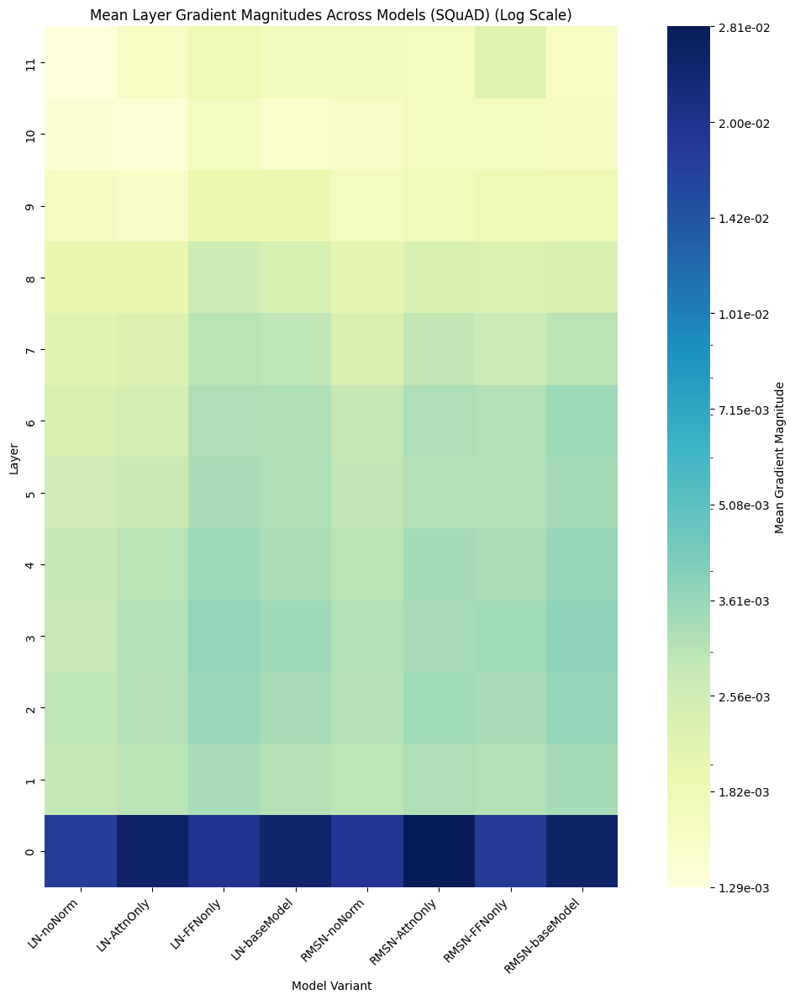

Loading Billsum dataset...
Processing shng2025/GPT-Valkyrie_LN-124m__noNorm__Billsum
  Processing example 1/50


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


  Processing example 2/50
  Processing example 3/50
  Processing example 4/50
  Processing example 5/50
  Processing example 6/50
  Processing example 7/50
  Processing example 8/50
  Processing example 9/50
  Processing example 10/50
  Processing example 11/50
  Processing example 12/50
  Processing example 13/50
  Processing example 14/50
  Processing example 15/50
  Processing example 16/50
  Processing example 17/50
  Processing example 18/50
  Processing example 19/50
  Processing example 20/50
  Processing example 21/50
  Processing example 22/50
  Processing example 23/50
  Processing example 24/50
  Processing example 25/50
  Processing example 26/50
  Processing example 27/50
  Processing example 28/50
  Processing example 29/50
  Processing example 30/50
  Processing example 31/50
  Processing example 32/50
  Processing example 33/50
  Processing example 34/50
  Processing example 35/50
  Processing example 36/50
  Processing example 37/50
  Processing example 38/50
  Process

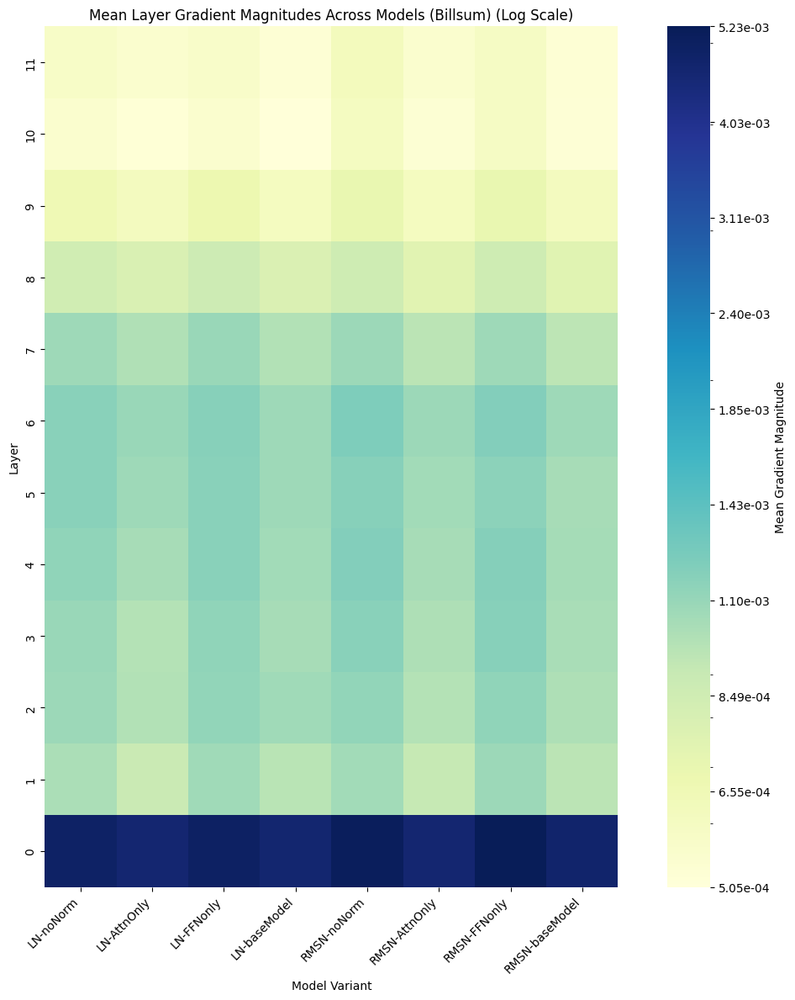

In [ ]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.colors import LogNorm
from datasets import load_dataset

def calculate_layer_averages(model, gradients):
    """Calculate average gradient magnitude for each layer."""
    layer_averages = []

    for i in range(len(model.transformer.h)):
        layer_grads = []
        prefix = f'transformer.h.{i}.'

        # Collect all gradients for this layer
        for name, value in gradients.items():
            if name.startswith(prefix):
                layer_grads.append(value)

        if layer_grads:
            layer_averages.append(np.mean(layer_grads))

    return layer_averages

def get_model_label(model_name):
    """Extract norm type and variant from model name."""
    # Split by double underscore to separate components
    parts = model_name.split('__')

    # Extract norm type (LN or RMSN)
    if "LN-124m" in parts[0]:
        norm_type = "LN"
    elif "RMSN-124m" in parts[0]:
        norm_type = "RMSN"
    else:
        norm_type = "unknown"

    # Extract variant from middle component
    if len(parts) > 1:
        variant = parts[1]  # This will be noNorm, AttnOnly, FFNonly, or baseModel
    else:
        variant = "unknown"

    return f"{norm_type}-{variant}"

def visualize_layer_gradients(all_layer_averages, model_variants, task_type, vmin=None, vmax=None, use_log_scale=True):
    """Visualize mean gradient magnitudes across layers."""
    # Convert to numpy array for easier manipulation
    averaged_gradients = np.array(all_layer_averages)

    num_layers = averaged_gradients.shape[1]
    num_models = len(model_variants)

    # Create figure
    plt.figure(figsize=(12, 12))

    # Set scale and limits
    if vmin is None:
        vmin = max(np.min(averaged_gradients), 1e-10)
    if vmax is None:
        vmax = np.max(averaged_gradients)

    # Prepare heatmap parameters
    heatmap_kwargs = {
        'cmap': "YlGnBu",
        'square': True,
        'annot': False,
        'cbar_kws': {
            'label': 'Mean Gradient Magnitude',
            'format': '%.2e' if use_log_scale else '%.2f',
            'ticks': np.logspace(np.log10(vmin), np.log10(vmax), 10) if use_log_scale else None
        }
    }

    if use_log_scale:
        heatmap_kwargs['norm'] = LogNorm(vmin=vmin, vmax=vmax)
    else:
        heatmap_kwargs['vmin'] = vmin
        heatmap_kwargs['vmax'] = vmax

    # Create heatmap
    ax = sns.heatmap(averaged_gradients.T, **heatmap_kwargs)

    # Format x-axis labels
    x_labels = [get_model_label(model) for model in model_variants]
    plt.xticks(np.arange(len(model_variants)) + 0.5,
               x_labels,
               rotation=45,
               ha='right')

    # Format y-axis
    plt.yticks(np.arange(num_layers) + 0.5,
               range(num_layers))

    # Invert y-axis to have 0 at bottom
    ax.invert_yaxis()

    plt.xlabel("Model Variant")
    plt.ylabel("Layer")
    scale_type = "Log" if use_log_scale else "Linear"
    plt.title(f"Mean Layer Gradient Magnitudes Across Models ({task_type}) ({scale_type} Scale)")

    plt.tight_layout()
    plt.show()

def run_analysis(model_variants, dataset, calc_func, task_type="SQuAD", num_samples=50):
    """Run gradient analysis across models and examples."""
    all_layer_averages = []

    # Select first num_samples examples
    if len(dataset) > num_samples:
        dataset = dataset.select(range(num_samples))

    for model_name in model_variants:
        print(f"Processing {model_name}")

        model_layer_averages = []
        for i, example in enumerate(dataset):
            print(f"  Processing example {i+1}/{len(dataset)}")
            gradients, model = calc_func(model_name, example)
            layer_averages = calculate_layer_averages(model, gradients)
            model_layer_averages.append(layer_averages)

            del model
            torch.cuda.empty_cache()

        # Average across examples
        avg_layer_gradients = np.mean(model_layer_averages, axis=0)
        all_layer_averages.append(avg_layer_gradients)

    # Visualize results
    visualize_layer_gradients(all_layer_averages, model_variants, task_type)

def run_squad_analysis():
    print("Loading SQuAD dataset...")
    dataset = load_dataset("squad", split="validation")

    model_variants = [
        "shng2025/GPT-Valkyrie_LN-124m__noNorm__SQuAD",
        "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__SQuAD",
        "shng2025/GPT-Valkyrie_LN-124m__FFNonly__SQuAD",
        "shng2025/GPT-Valkyrie_LN-124m__baseModel__SQuAD",
        "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__SQuAD",
        "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__SQuAD",
        "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__SQuAD",
        "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__SQuAD",
    ]

    run_analysis(model_variants, dataset, calculate_gradient_magnitudes_squad, "SQuAD")

def run_billsum_analysis():
    print("Loading Billsum dataset...")
    dataset = load_dataset("billsum", split="ca_test")

    model_variants = [
        "shng2025/GPT-Valkyrie_LN-124m__noNorm__Billsum",
        "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__Billsum",
        "shng2025/GPT-Valkyrie_LN-124m__FFNonly__Billsum",
        "shng2025/GPT-Valkyrie_LN-124m__baseModel__Billsum",
        "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__Billsum",
        "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__Billsum",
        "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__Billsum",
        "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__Billsum",
    ]

    run_analysis(model_variants, dataset, calculate_gradient_magnitudes_billsum, "Billsum")

if __name__ == "__main__":
    # Run either or both analyses as needed
    run_squad_analysis()
    run_billsum_analysis()

Loading SQuAD dataset...
Processing shng2025/GPT-Valkyrie_LN-124m__noNorm__SQuAD
  Processing example 1/50


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


  Processing example 2/50
  Processing example 3/50
  Processing example 4/50
  Processing example 5/50
  Processing example 6/50
  Processing example 7/50
  Processing example 8/50
  Processing example 9/50
  Processing example 10/50
  Processing example 11/50
  Processing example 12/50
  Processing example 13/50
  Processing example 14/50
  Processing example 15/50
  Processing example 16/50
  Processing example 17/50
  Processing example 18/50
  Processing example 19/50
  Processing example 20/50
  Processing example 21/50
  Processing example 22/50
  Processing example 23/50
  Processing example 24/50
  Processing example 25/50
  Processing example 26/50
  Processing example 27/50
  Processing example 28/50
  Processing example 29/50
  Processing example 30/50
  Processing example 31/50
  Processing example 32/50
  Processing example 33/50
  Processing example 34/50
  Processing example 35/50
  Processing example 36/50
  Processing example 37/50
  Processing example 38/50
  Process

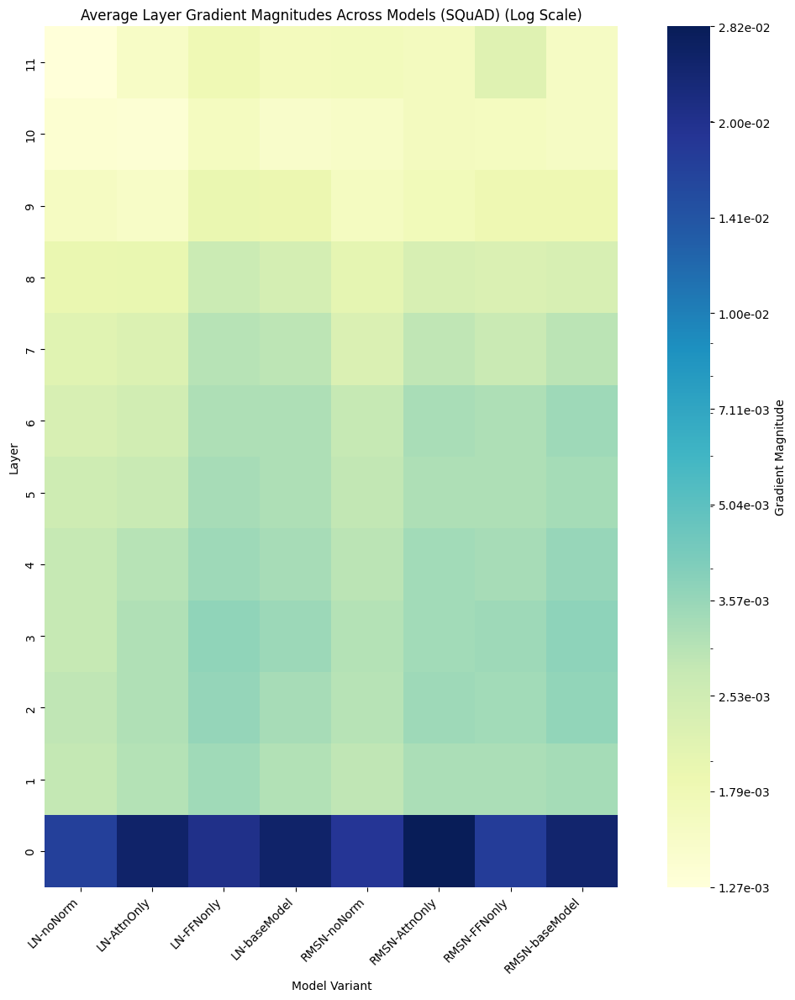

Loading Billsum dataset...
Processing shng2025/GPT-Valkyrie_LN-124m__noNorm__Billsum
  Processing example 1/50


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


  Processing example 2/50
  Processing example 3/50
  Processing example 4/50
  Processing example 5/50
  Processing example 6/50
  Processing example 7/50
  Processing example 8/50
  Processing example 9/50
  Processing example 10/50
  Processing example 11/50
  Processing example 12/50
  Processing example 13/50
  Processing example 14/50
  Processing example 15/50
  Processing example 16/50
  Processing example 17/50
  Processing example 18/50
  Processing example 19/50
  Processing example 20/50
  Processing example 21/50
  Processing example 22/50
  Processing example 23/50
  Processing example 24/50
  Processing example 25/50
  Processing example 26/50
  Processing example 27/50
  Processing example 28/50
  Processing example 29/50
  Processing example 30/50
  Processing example 31/50
  Processing example 32/50
  Processing example 33/50
  Processing example 34/50
  Processing example 35/50
  Processing example 36/50
  Processing example 37/50
  Processing example 38/50
  Process

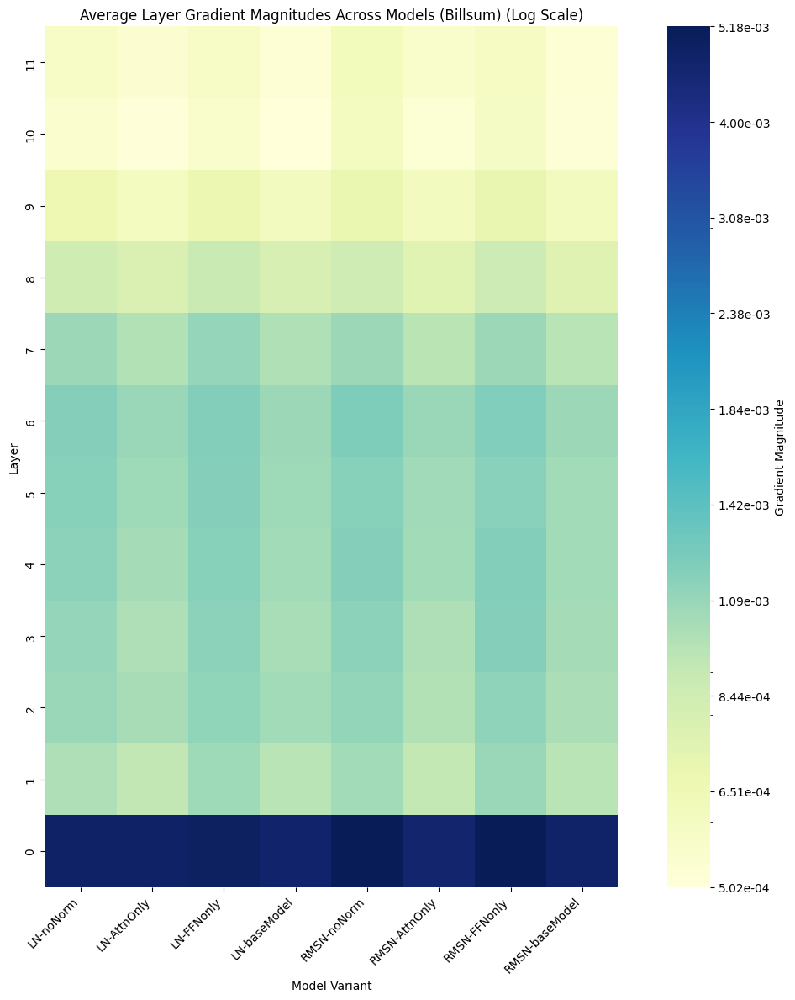

In [ ]:
import pandas as pd
import os

def save_gradients_to_csv(all_layer_averages, model_variants, task_type, output_dir="gradient_results"):
    """Save gradient values to CSV file."""
    # Create output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)

    # Convert to DataFrame
    df = pd.DataFrame(all_layer_averages, index=model_variants)

    # Add column names for layers
    df.columns = [f"layer_{i}" for i in range(df.shape[1])]

    # Save to CSV
    filename = os.path.join(output_dir, f"{task_type}_gradients.csv")
    df.to_csv(filename)
    print(f"Saved gradient values to {filename}")
    return filename

def load_gradients_from_csv(task_type, input_dir="gradient_results"):
    """Load gradient values from CSV file."""
    filename = os.path.join(input_dir, f"{task_type}_gradients.csv")
    if not os.path.exists(filename):
        raise FileNotFoundError(f"No gradient file found for {task_type}")

    df = pd.read_csv(filename, index_col=0)
    return df.values.tolist(), df.index.tolist()

def visualize_layer_gradients(all_layer_averages, model_variants, task_type="", vmin=None, vmax=None, use_log_scale=True):
    """Visualize gradient magnitudes across layers and models."""
    # Handle different input formats
    if isinstance(all_layer_averages, list):
        # Convert list to numpy array
        all_layer_averages = np.array(all_layer_averages)

    # Handle different dimensionalities
    if all_layer_averages.ndim == 3:  # For text generation (models, prompts, layers)
        averaged_gradients = np.mean(all_layer_averages, axis=1)
    elif all_layer_averages.ndim == 2:  # For Squad/Billsum (models, layers)
        averaged_gradients = all_layer_averages
    else:
        raise ValueError(f"Unexpected gradient array shape: {all_layer_averages.shape}")

    num_layers = averaged_gradients.shape[1]
    num_models = len(model_variants)

    # Create figure with specific aspect ratio for square cells
    plt.figure(figsize=(12, 12))

    # Set scale and limits
    if vmin is None:
        vmin = max(np.min(averaged_gradients), 1e-10)
    if vmax is None:
        vmax = np.max(averaged_gradients)

    # Create heatmap without annotations
    heatmap_kwargs = {
        'data': averaged_gradients.T,
        'cmap': "YlGnBu",
        'annot': False,
        'square': True,
    }

    if use_log_scale:
        heatmap_kwargs.update({
            'norm': LogNorm(vmin=vmin, vmax=vmax),
            'cbar_kws': {
                'label': 'Gradient Magnitude',
                'format': '%.2e',
                'ticks': np.logspace(np.log10(vmin), np.log10(vmax), 10)
            }
        })
    else:
        heatmap_kwargs.update({
            'vmin': vmin,
            'vmax': vmax,
            'cbar_kws': {
                'label': 'Gradient Magnitude',
                'format': '%.2f'
            }
        })

    ax = sns.heatmap(**heatmap_kwargs)

    # Format x-axis labels using the improved label extraction
    x_labels = [get_model_label(model) for model in model_variants]
    plt.xticks(np.arange(len(model_variants)) + 0.5,
               x_labels,
               rotation=45,
               ha='right')

    # Format y-axis with proper layer numbering (0 to num_layers-1)
    plt.yticks(np.arange(num_layers) + 0.5,
               range(num_layers))

    # Invert y-axis to have 0 at bottom
    ax.invert_yaxis()

    plt.xlabel("Model Variant")
    plt.ylabel("Layer")
    scale_type = "Log" if use_log_scale else "Linear"
    plt.title(f"Average Layer Gradient Magnitudes Across Models ({task_type}) ({scale_type} Scale)")

    plt.tight_layout()
    plt.show()

def run_analysis(model_variants, dataset, calc_func, task_type="", num_samples=50, force_recalculate=False):
    """Run gradient analysis with CSV caching."""
    # Try to load from CSV first if not forcing recalculation
    if not force_recalculate:
        try:
            averaged_gradients, loaded_models = load_gradients_from_csv(task_type)
            print(f"Loaded cached gradients for {task_type}")
            visualize_layer_gradients(averaged_gradients, model_variants, task_type)
            return
        except FileNotFoundError:
            print(f"No cached gradients found for {task_type}, calculating...")

    # Select first num_samples examples
    if len(dataset) > num_samples:
        dataset = dataset.select(range(num_samples))

    all_layer_averages = []

    for model_name in model_variants:
        print(f"Processing {model_name}")
        model_averages = []

        for i, example in enumerate(dataset):
            print(f"  Processing example {i+1}/{len(dataset)}")
            gradients, model = calc_func(model_name, example)
            layer_averages = calculate_layer_averages(model, gradients)
            model_averages.append(layer_averages)

            del model
            torch.cuda.empty_cache()

        # Average across examples for this model
        avg_layer_gradients = np.mean(model_averages, axis=0)
        all_layer_averages.append(avg_layer_gradients)

    # Save results to CSV
    save_gradients_to_csv(np.array(all_layer_averages), model_variants, task_type)

    # Visualize results
    visualize_layer_gradients(all_layer_averages, model_variants, task_type)

def run_squad_analysis(force_recalculate=False):
    """Run SQuAD analysis with optional force recalculation."""
    print("Loading SQuAD dataset...")
    dataset = load_dataset("squad", split="validation")

    model_variants = [
        "shng2025/GPT-Valkyrie_LN-124m__noNorm__SQuAD",
        "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__SQuAD",
        "shng2025/GPT-Valkyrie_LN-124m__FFNonly__SQuAD",
        "shng2025/GPT-Valkyrie_LN-124m__baseModel__SQuAD",
        "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__SQuAD",
        "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__SQuAD",
        "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__SQuAD",
        "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__SQuAD",
    ]

    run_analysis(model_variants, dataset, calculate_gradient_magnitudes_squad,
                "SQuAD", force_recalculate=force_recalculate)

def run_billsum_analysis(force_recalculate=False):
    """Run Billsum analysis with optional force recalculation."""
    print("Loading Billsum dataset...")
    dataset = load_dataset("billsum", split="ca_test")

    model_variants = [
        "shng2025/GPT-Valkyrie_LN-124m__noNorm__Billsum",
        "shng2025/GPT-Valkyrie_LN-124m__AttnOnly__Billsum",
        "shng2025/GPT-Valkyrie_LN-124m__FFNonly__Billsum",
        "shng2025/GPT-Valkyrie_LN-124m__baseModel__Billsum",
        "shng2025/GPT-Valkyrie_RMSN-124m__noNorm__Billsum",
        "shng2025/GPT-Valkyrie_RMSN-124m__AttnOnly__Billsum",
        "shng2025/GPT-Valkyrie_RMSN-124m__FFNonly__Billsum",
        "shng2025/GPT-Valkyrie_RMSN-124m__baseModel__Billsum",
    ]

    run_analysis(model_variants, dataset, calculate_gradient_magnitudes_billsum,
                "Billsum", force_recalculate=force_recalculate)

if __name__ == "__main__":
    # Run analyses
    # Set force_recalculate=True to ignore cached results and recalculate
    run_squad_analysis(force_recalculate=True)
    run_billsum_analysis(force_recalculate=True)